In [2]:
from torch import Tensor, nn

from torch.distributions.categorical import Categorical
from torch.nn import functional as F
from tqdm.auto import tqdm
from transformer_lens import ActivationCache, HookedTransformer, utils
from transformer_lens.hook_points import HookPoint
from tqdm import tqdm
import numpy as np
import pandas as pd
import gc
import requests
import os
import sys
import json
from salmon.triplets.offline import OfflineEmbedding
from sklearn.model_selection import train_test_split

2025-08-28 09:20:02.331656: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-08-28 09:20:04.991391: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1756390806.689845 3717328 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1756390807.166784 3717328 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1756390810.123424 3717328 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking 

In [83]:
# --- Human baseline ---
embed_human = pd.read_csv("../data/spose/embeddings_human_out.csv")

# --- Gemma-2 series ---
embed_gemma_2_2b    = pd.read_csv("../results/1a/embed_out/gemma-2-2b/embeddings_gemma-2-2b.csv")
embed_gemma_2_2b_it = pd.read_csv("../results/1a/embed_out/gemma-2-2b-it/embeddings_gemma-2-2b-it.csv")
embed_gemma_2_9b    = pd.read_csv("../results/1a/embed_out/gemma-2-9b/embeddings_gemma-2-9b.csv")
embed_gemma_2_9b_it = pd.read_csv("../results/1a/embed_out/gemma-2-9b-it/embeddings_gemma-2-9b-it.csv")

# --- Gemma-3 series ---
embed_gemma_3_4b_it  = pd.read_csv("../results/1a/embed_out/gemma-3-4b-it/embeddings_gemma-3-4b-it.csv")
embed_gemma_3_4b_pt  = pd.read_csv("../results/1a/embed_out/gemma-3-4b-pt/embeddings_gemma-3-4b-pt.csv")
embed_gemma_3_12b_it = pd.read_csv("../results/1a/embed_out/gemma-3-12b-it/embeddings_gemma-3-12b-it.csv")
embed_gemma_3_12b_pt = pd.read_csv("../results/1a/embed_out/gemma-3-12b-pt/embeddings_gemma-3-12b-pt.csv")
embed_gemma_3_270m   = pd.read_csv("../results/1a/embed_out/gemma-3-270m/embeddings_gemma-3-270m.csv")
embed_gemma_3_270m_it= pd.read_csv("../results/1a/embed_out/gemma-3-270m-it/embeddings_gemma-3-270m-it.csv")

# --- LLaMA-2 series ---
embed_llama2_7b      = pd.read_csv("../results/1a/embed_out/llama2-7b/embeddings_llama2-7b.csv")
embed_llama2_7b_chat = pd.read_csv("../results/1a/embed_out/llama2-7b-chat/embeddings_llama2-7b-chat.csv")
embed_llama2_13b     = pd.read_csv("../results/1a/embed_out/llama2-13b/embeddings_llama2-13b.csv")


In [84]:
###human embeddings postproc

filtered = embed_human[embed_human["item"].isin(embed_gemma_2_2b["item"])].copy()


embed_split = filtered["embedding"].str.strip().str.split(r"\s+")

# convert list-of-strings to a numpy array of floats
embed_array = np.array(embed_split.tolist(), dtype=float)

embed_df = pd.DataFrame(embed_array, columns=[f"dim_{i}" for i in range(embed_array.shape[1])])

embed_human = pd.concat([filtered[["item"]].reset_index(drop=True), embed_df], axis=1)

In [85]:
cols_keep = ["item"] + [f"dim_{i}" for i in range(30)]
embed_human = embed_human[cols_keep].copy()


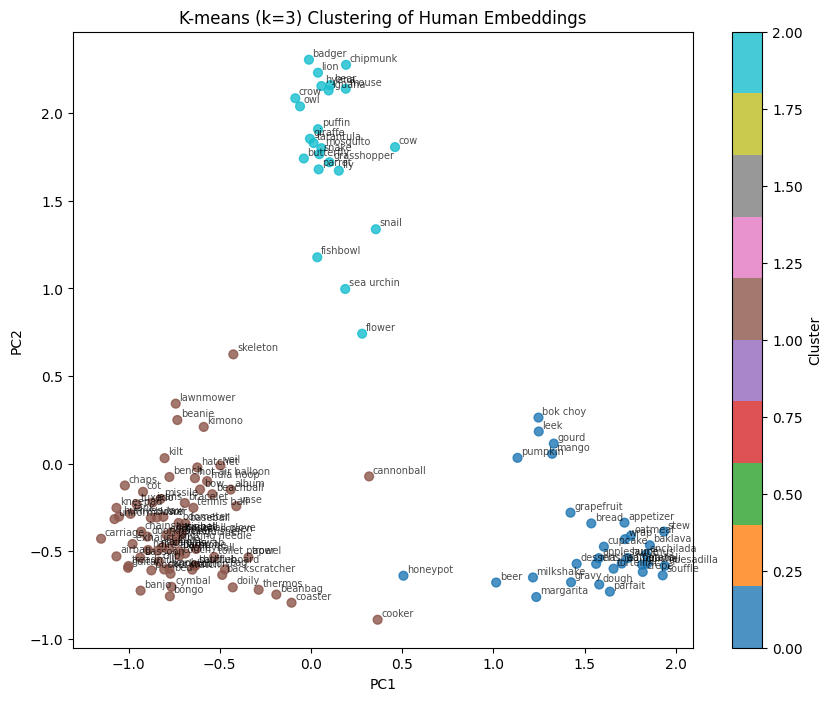

In [13]:
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# --- Features only ---
X = embed_human.filter(like="dim_").values

# --- KMeans with k=3 ---
kmeans = KMeans(n_clusters=3, random_state=42, n_init="auto").fit(X)
labels = kmeans.labels_

embed_human["cluster"] = labels

# --- PCA for visualization ---
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(X)

# --- Plot with labels ---
plt.figure(figsize=(10,8))
scatter = plt.scatter(X_pca[:,0], X_pca[:,1], c=labels, cmap="tab10", s=40, alpha=0.8)
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title("K-means (k=3) Clustering of Human Embeddings")

# add text labels from the "item" column
for i, txt in enumerate(embed_human["item"]):
    plt.text(X_pca[i,0]+0.02, X_pca[i,1]+0.02, txt, fontsize=7, alpha=0.7)

plt.colorbar(scatter, label="Cluster")
plt.show()


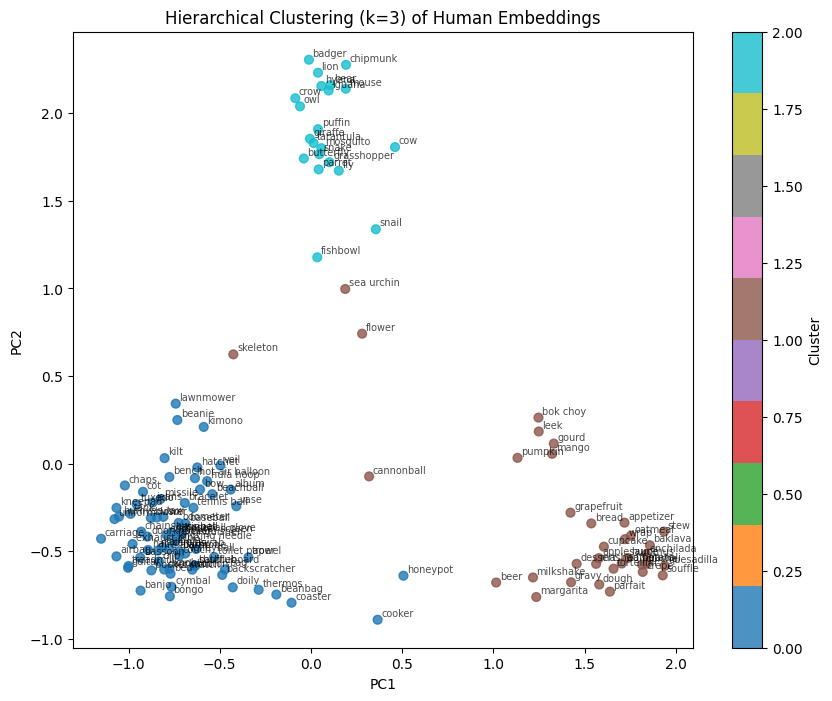

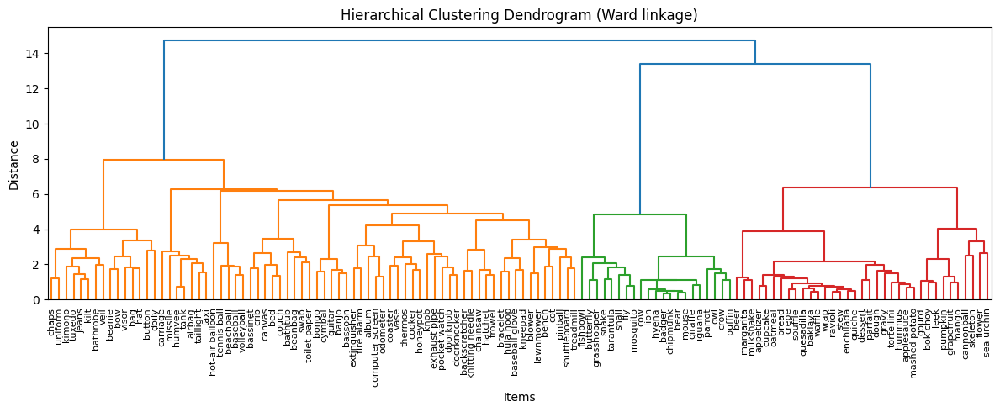

In [14]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage

# --- Features only ---
X = embed_human.filter(like="dim_").values

# --- Hierarchical clustering (agglomerative) ---
hclust = AgglomerativeClustering(n_clusters=3, linkage="ward")
labels = hclust.fit_predict(X)
embed_human["h_cluster"] = labels

# --- PCA for visualization ---
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(X)

# --- PCA scatter colored by hierarchical cluster ---
plt.figure(figsize=(10,8))
scatter = plt.scatter(X_pca[:,0], X_pca[:,1], c=labels, cmap="tab10", s=40, alpha=0.8)
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title("Hierarchical Clustering (k=3) of Human Embeddings")

for i, txt in enumerate(embed_human["item"]):
    plt.text(X_pca[i,0]+0.02, X_pca[i,1]+0.02, txt, fontsize=7, alpha=0.7)

plt.colorbar(scatter, label="Cluster")
plt.show()

# --- Dendrogram ---
plt.figure(figsize=(12, 5))
Z = linkage(X, method="ward")
dendrogram(Z, labels=embed_human["item"].tolist(), leaf_rotation=90, leaf_font_size=8)
plt.title("Hierarchical Clustering Dendrogram (Ward linkage)")
plt.xlabel("Items")
plt.ylabel("Distance")
plt.tight_layout()
plt.show()


In [15]:
embed_gemma_2_2b.head()

,item,id,dim_0,dim_1,dim_2,dim_3,dim_4,dim_5,dim_6,dim_7,...,dim_20,dim_21,dim_22,dim_23,dim_24,dim_25,dim_26,dim_27,dim_28,dim_29
0,airbag,0,-0.034679,0.013552,0.080045,-0.026063,-0.014747,0.011373,0.077033,-0.050951,...,0.078176,-0.067181,0.131990,-0.066256,-0.061316,0.048977,-0.009340,0.131167,0.010365,0.066247
1,album,1,0.021021,0.001282,0.102685,0.038837,-0.105589,-0.088489,0.055735,-0.001670,...,0.076157,-0.090653,0.110617,0.009646,-0.038163,0.028241,-0.032682,0.105993,0.037306,0.057263
2,appetizer,2,0.090145,-0.048522,0.153706,-0.124834,0.171935,0.056610,-0.071779,-0.219532,...,-0.054141,-0.024158,-0.058194,0.144742,0.010710,0.042912,-0.189721,-0.003112,0.113345,0.141934
3,applesauce,3,0.033643,0.027724,0.067947,0.039848,0.082463,0.044064,0.036615,-0.040969,...,-0.092320,-0.019316,0.070722,-0.005452,-0.057899,-0.005877,-0.019175,0.011557,0.049093,0.038593
4,backscratcher,4,0.040917,0.127098,-0.075189,-0.009780,0.145964,0.022894,-0.072740,0.045366,...,0.003675,-0.046676,0.058927,-0.115690,-0.006777,-0.032314,0.000679,-0.076068,0.053239,-0.040651


/tmp/ipykernel_3717328/81690858.py:71: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


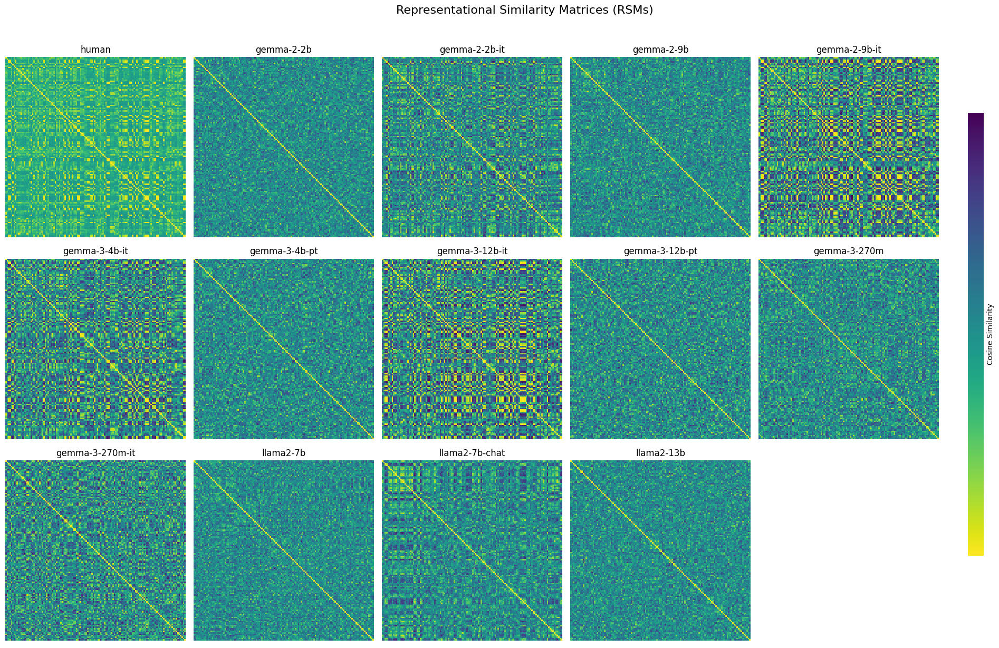

In [45]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity

# --- Embedding sets (all models + human) ---
embeddings_dict = {
    "human": embed_human,
    "gemma-2-2b": embed_gemma_2_2b,
    "gemma-2-2b-it": embed_gemma_2_2b_it,
    "gemma-2-9b": embed_gemma_2_9b,
    "gemma-2-9b-it": embed_gemma_2_9b_it,
    "gemma-3-4b-it": embed_gemma_3_4b_it,
    "gemma-3-4b-pt": embed_gemma_3_4b_pt,
    "gemma-3-12b-it": embed_gemma_3_12b_it,
    "gemma-3-12b-pt": embed_gemma_3_12b_pt,
    "gemma-3-270m": embed_gemma_3_270m,
    "gemma-3-270m-it": embed_gemma_3_270m_it,
    "llama2-7b": embed_llama2_7b,
    "llama2-7b-chat": embed_llama2_7b_chat,
    "llama2-13b": embed_llama2_13b,
}

# --- Compute RSMs ---
rsm_dict = {}
for name, df in embeddings_dict.items():
    X = df.filter(like="dim_").values
    rsm_dict[name] = cosine_similarity(X)

# --- Global min/max for shared colormap ---
all_vals = np.concatenate([r.flatten() for r in rsm_dict.values()])
vmin, vmax = all_vals.min(), all_vals.max()

# --- Plot grid ---
n_models = len(rsm_dict)
n_cols = 5
n_rows = int(np.ceil(n_models / n_cols))

fig, axes = plt.subplots(n_rows, n_cols, figsize=(4*n_cols, 4*n_rows))

axes = axes.flatten()

for ax, (name, rsm) in zip(axes, rsm_dict.items()):
    sns.heatmap(
        rsm,
        xticklabels=False, yticklabels=False,
        cmap="viridis",
        square=True,
        vmin=vmin, vmax=vmax,   # <- shared coloring
        cbar=False,
        ax=ax
    )
    ax.set_title(name)

# Turn off unused subplots
for ax in axes[len(rsm_dict):]:
    ax.axis("off")

# --- Shared colorbar ---
cbar_ax = fig.add_axes([0.92, 0.15, 0.015, 0.7])
sns.heatmap(
    np.array([[0,1]]), cmap="viridis",
    vmin=vmin, vmax=vmax,
    cbar=True, cbar_ax=cbar_ax,
    xticklabels=False, yticklabels=False
)
cbar_ax.set_ylabel("Cosine Similarity")

plt.suptitle("Representational Similarity Matrices (RSMs)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 0.9, 1])
plt.show()


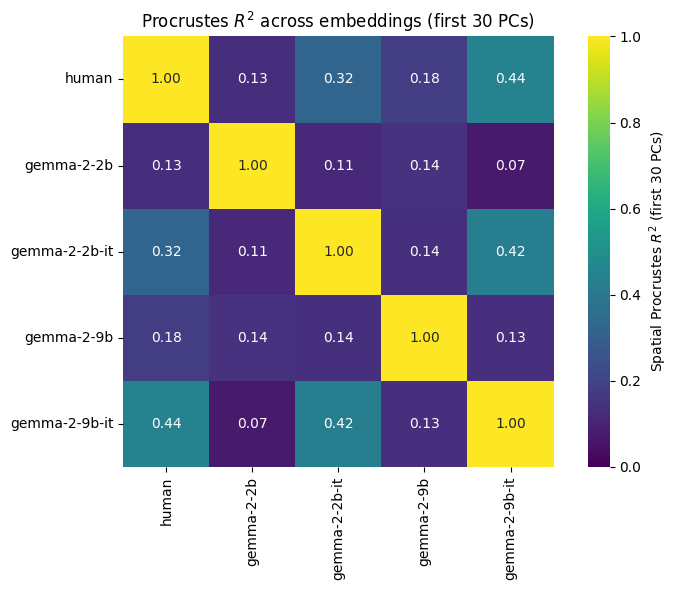

                  human  gemma-2-2b  gemma-2-2b-it  gemma-2-9b  gemma-2-9b-it
human          1.000000    0.132079       0.323057    0.179075       0.440498
gemma-2-2b     0.132079    1.000000       0.109992    0.141317       0.067545
gemma-2-2b-it  0.323057    0.109992       1.000000    0.136732       0.423469
gemma-2-9b     0.179075    0.141317       0.136732    1.000000       0.133188
gemma-2-9b-it  0.440498    0.067545       0.423469    0.133188       1.000000


In [36]:
from sklearn.decomposition import PCA
from scipy.spatial import procrustes
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# --- Procrustes R² via scipy.spatial (center+scale to unit Frobenius) ---
def procrustes_r2_spatial(X, Y):
    _, _, disparity = procrustes(X, Y)
    R2 = 1.0 - float(disparity)
    # numerical guard to keep in [0, 1]
    return float(np.clip(R2, 0.0, 1.0))

# --- Align by item, project each set to its own PCA space, then compare ---
def rotated_procrustes(df1, df2, n_dims):
    shared = sorted(set(df1["item"]).intersection(df2["item"]))
    if not shared:
        return np.nan
    A = df1[df1["item"].isin(shared)].sort_values("item")
    B = df2[df2["item"].isin(shared)].sort_values("item")

    X1 = A.filter(like="dim_").iloc[:, :n_dims].values
    X2 = B.filter(like="dim_").iloc[:, :n_dims].values

    # project each to its own PCA axes (keeps shapes equal)
    X1_rot = PCA(n_components=min(n_dims, X1.shape[1])).fit_transform(X1)
    X2_rot = PCA(n_components=min(n_dims, X2.shape[1])).fit_transform(X2)

    # ensure same dimensionality (just in case)
    k = min(X1_rot.shape[1], X2_rot.shape[1])
    X1_rot = X1_rot[:, :k]
    X2_rot = X2_rot[:, :k]

    return procrustes_r2_spatial(X1_rot, X2_rot)

# --- Compare all embeddings ---
embeddings = {
    "human": embed_human,
    "gemma-2-2b": embed_gemma_2_2b,
    "gemma-2-2b-it": embed_gemma_2_2b_it,
    "gemma-2-9b": embed_gemma_2_9b,
    "gemma-2-9b-it": embed_gemma_2_9b_it,
}

names = list(embeddings.keys())
n_dims = 30
n = len(names)

# --- Compute R² matrix ---
M = np.eye(n)
for i in range(n):
    for j in range(i + 1, n):
        r2 = rotated_procrustes(embeddings[names[i]], embeddings[names[j]], n_dims)
        M[i, j] = M[j, i] = r2

# --- Plot ---
r2_df = pd.DataFrame(M, index=names, columns=names)
plt.figure(figsize=(8, 6))
sns.heatmap(r2_df, annot=True, fmt=".2f", cmap="viridis", square=True,
            vmin=0, vmax=1, cbar_kws={"label": f"Spatial Procrustes $R^2$ (first {n_dims} PCs)"})
plt.title(f"Procrustes $R^2$ across embeddings (first {n_dims} PCs)")
plt.tight_layout()
plt.show()

print(r2_df)


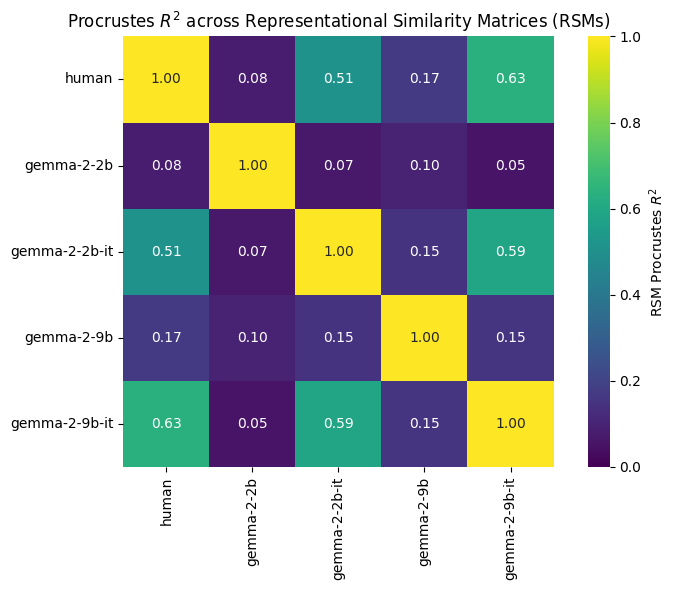

                  human  gemma-2-2b  gemma-2-2b-it  gemma-2-9b  gemma-2-9b-it
human          1.000000    0.080888       0.511435    0.170681       0.633781
gemma-2-2b     0.080888    1.000000       0.066012    0.096592       0.051602
gemma-2-2b-it  0.511435    0.066012       1.000000    0.147463       0.586925
gemma-2-9b     0.170681    0.096592       0.147463    1.000000       0.153436
gemma-2-9b-it  0.633781    0.051602       0.586925    0.153436       1.000000


In [38]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
from scipy.spatial import procrustes

# --- Helper: Procrustes R² using scipy.spatial ---
def procrustes_r2_spatial(X, Y):
    _, _, disparity = procrustes(X, Y)
    return float(np.clip(1 - disparity, 0.0, 1.0))

# --- Embedding sets ---
embeddings_dict = {
    "human": embed_human,
    "gemma-2-2b": embed_gemma_2_2b,
    "gemma-2-2b-it": embed_gemma_2_2b_it,
    "gemma-2-9b": embed_gemma_2_9b,
    "gemma-2-9b-it": embed_gemma_2_9b_it,
}

# --- Compute RSMs (cosine similarity across items) ---
rsm_dict = {}
for name, df in embeddings_dict.items():
    X = df.filter(like="dim_").values
    rsm_dict[name] = cosine_similarity(X)

# --- Compute Procrustes R² matrix over RSMs ---
names = list(rsm_dict.keys())
n = len(names)
M = np.eye(n)

for i in range(n):
    for j in range(i + 1, n):
        r2 = procrustes_r2_spatial(rsm_dict[names[i]], rsm_dict[names[j]])
        M[i, j] = M[j, i] = r2

# --- Plot ---
r2_df = pd.DataFrame(M, index=names, columns=names)
plt.figure(figsize=(8, 6))
sns.heatmap(r2_df, annot=True, fmt=".2f", cmap="viridis", square=True,
            vmin=0, vmax=1, cbar_kws={"label": "RSM Procrustes $R^2$"})
plt.title("Procrustes $R^2$ across Representational Similarity Matrices (RSMs)")
plt.tight_layout()
plt.show()

print(r2_df)



/tmp/ipykernel_3717328/3916472942.py:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df_sorted, x="R2", y="pair", ax=ax, palette="viridis")
/tmp/ipykernel_3717328/3916472942.py:77: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df_sorted, x="R2", y="pair", ax=ax, palette="viridis")


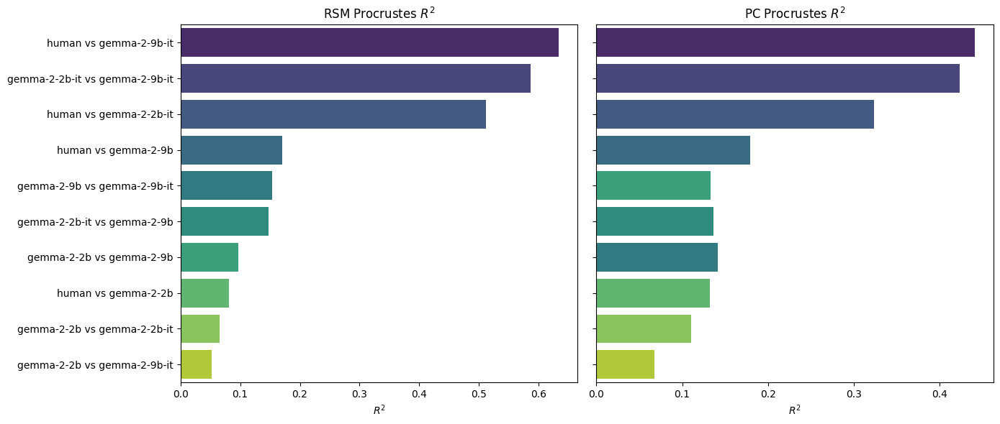

In [40]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.decomposition import PCA
from scipy.spatial import procrustes

# --- Helper: Procrustes R² ---
def procrustes_r2_spatial(X, Y):
    _, _, disparity = procrustes(X, Y)
    return float(np.clip(1 - disparity, 0.0, 1.0))

# --- Embedding sets ---
embeddings_dict = {
    "human": embed_human,
    "gemma-2-2b": embed_gemma_2_2b,
    "gemma-2-2b-it": embed_gemma_2_2b_it,
    "gemma-2-9b": embed_gemma_2_9b,
    "gemma-2-9b-it": embed_gemma_2_9b_it,
}
names = list(embeddings_dict.keys())
n = len(names)

# --- RSM Procrustes R² matrix ---
rsm_dict = {name: cosine_similarity(df.filter(like="dim_").values)
            for name, df in embeddings_dict.items()}
M_rsm = np.eye(n)
for i in range(n):
    for j in range(i+1, n):
        r2 = procrustes_r2_spatial(rsm_dict[names[i]], rsm_dict[names[j]])
        M_rsm[i, j] = M_rsm[j, i] = r2
r2_rsm_df = pd.DataFrame(M_rsm, index=names, columns=names)

# --- PC Procrustes R² matrix ---
def rotated_procrustes(df1, df2, n_dims=30):
    shared = sorted(set(df1["item"]).intersection(df2["item"]))
    A = df1[df1["item"].isin(shared)].sort_values("item")
    B = df2[df2["item"].isin(shared)].sort_values("item")
    X1 = A.filter(like="dim_").iloc[:, :n_dims].values
    X2 = B.filter(like="dim_").iloc[:, :n_dims].values
    X1_rot = PCA(n_components=min(n_dims, X1.shape[1])).fit_transform(X1)
    X2_rot = PCA(n_components=min(n_dims, X2.shape[1])).fit_transform(X2)
    k = min(X1_rot.shape[1], X2_rot.shape[1])
    return procrustes_r2_spatial(X1_rot[:, :k], X2_rot[:, :k])

M_pc = np.eye(n)
for i in range(n):
    for j in range(i+1, n):
        r2 = rotated_procrustes(embeddings_dict[names[i]], embeddings_dict[names[j]])
        M_pc[i, j] = M_pc[j, i] = r2
r2_pc_df = pd.DataFrame(M_pc, index=names, columns=names)

# --- Flatten, sort, and prepare barplot data ---
def melt_and_sort(r2_df, method_name):
    pairs = []
    for i in range(len(r2_df)):
        for j in range(i+1, len(r2_df)):
            pairs.append({
                "pair": f"{r2_df.index[i]} vs {r2_df.index[j]}",
                "R2": r2_df.iloc[i, j],
                "method": method_name
            })
    return pd.DataFrame(pairs)

df_rsm_long = melt_and_sort(r2_rsm_df, "RSM")
df_pc_long  = melt_and_sort(r2_pc_df,  "PC")

# --- Plot bar plots ---
fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=True)

for ax, df_long, title in zip(
    axes, [df_rsm_long, df_pc_long],
    ["RSM Procrustes $R^2$", "PC Procrustes $R^2$"]
):
    df_sorted = df_long.sort_values("R2", ascending=False)
    sns.barplot(data=df_sorted, x="R2", y="pair", ax=ax, palette="viridis")
    ax.set_title(title)
    ax.set_xlabel("$R^2$")
    ax.set_ylabel("")

plt.tight_layout()
plt.show()


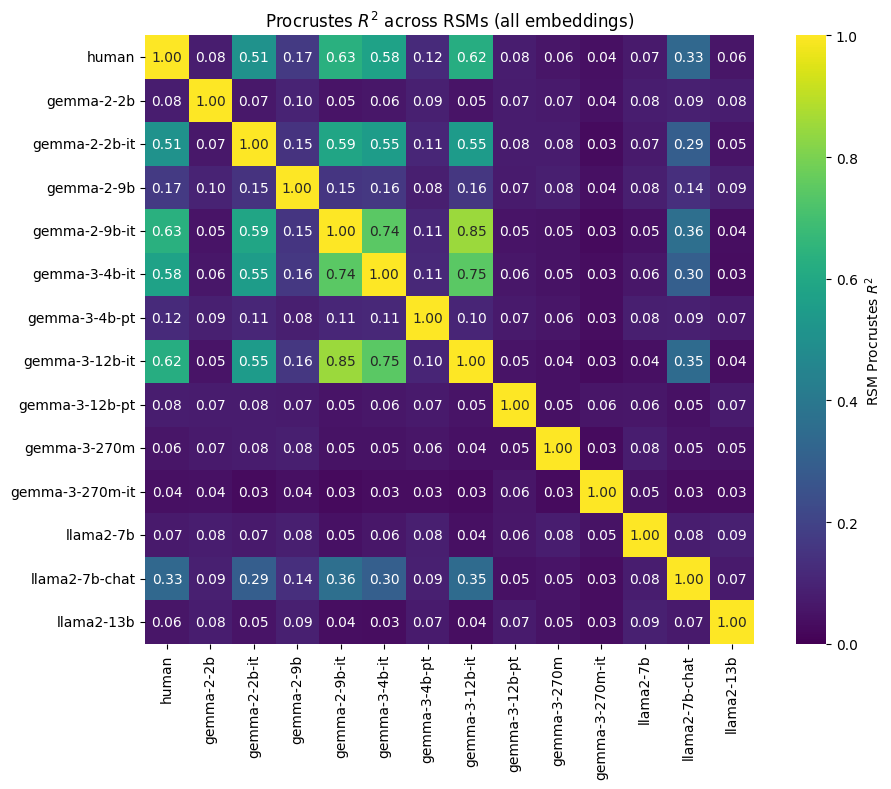

                    human  gemma-2-2b  gemma-2-2b-it  gemma-2-9b  \
human            1.000000    0.080888       0.511435    0.170681   
gemma-2-2b       0.080888    1.000000       0.066012    0.096592   
gemma-2-2b-it    0.511435    0.066012       1.000000    0.147463   
gemma-2-9b       0.170681    0.096592       0.147463    1.000000   
gemma-2-9b-it    0.633781    0.051602       0.586925    0.153436   
gemma-3-4b-it    0.577902    0.058635       0.550420    0.160664   
gemma-3-4b-pt    0.119092    0.086714       0.108800    0.084000   
gemma-3-12b-it   0.621459    0.053331       0.546179    0.157055   
gemma-3-12b-pt   0.079230    0.074973       0.076770    0.073825   
gemma-3-270m     0.058320    0.067337       0.077921    0.084845   
gemma-3-270m-it  0.041857    0.043141       0.027408    0.040522   
llama2-7b        0.069802    0.079381       0.067554    0.082430   
llama2-7b-chat   0.334108    0.089474       0.294530    0.135144   
llama2-13b       0.057068    0.080128       0.05

In [46]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
from scipy.spatial import procrustes

# --- Helper: Procrustes R² ---
def procrustes_r2_spatial(X, Y):
    _, _, disparity = procrustes(X, Y)
    return float(np.clip(1 - disparity, 0.0, 1.0))

# --- Embedding sets (all models + human) ---
embeddings_dict = {
    "human": embed_human,
    "gemma-2-2b": embed_gemma_2_2b,
    "gemma-2-2b-it": embed_gemma_2_2b_it,
    "gemma-2-9b": embed_gemma_2_9b,
    "gemma-2-9b-it": embed_gemma_2_9b_it,
    "gemma-3-4b-it": embed_gemma_3_4b_it,
    "gemma-3-4b-pt": embed_gemma_3_4b_pt,
    "gemma-3-12b-it": embed_gemma_3_12b_it,
    "gemma-3-12b-pt": embed_gemma_3_12b_pt,
    "gemma-3-270m": embed_gemma_3_270m,
    "gemma-3-270m-it": embed_gemma_3_270m_it,
    "llama2-7b": embed_llama2_7b,
    "llama2-7b-chat": embed_llama2_7b_chat,
    "llama2-13b": embed_llama2_13b,
}

names = list(embeddings_dict.keys())
n = len(names)

# --- Compute RSMs (cosine similarity across items) ---
rsm_dict = {name: cosine_similarity(df.filter(like="dim_").values)
            for name, df in embeddings_dict.items()}

# --- Procrustes R² over RSMs ---
M_rsm = np.eye(n)
for i in range(n):
    for j in range(i+1, n):
        r2 = procrustes_r2_spatial(rsm_dict[names[i]], rsm_dict[names[j]])
        M_rsm[i, j] = M_rsm[j, i] = r2

r2_rsm_df = pd.DataFrame(M_rsm, index=names, columns=names)

# --- Plot heatmap ---
plt.figure(figsize=(10, 8))
sns.heatmap(r2_rsm_df, annot=True, fmt=".2f", cmap="viridis", square=True,
            vmin=0, vmax=1, cbar_kws={"label": "RSM Procrustes $R^2$"})
plt.title("Procrustes $R^2$ across RSMs (all embeddings)")
plt.tight_layout()
plt.show()

print(r2_rsm_df)


/tmp/ipykernel_3717328/3369043017.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df_human, x="R2", y="model", palette="viridis")


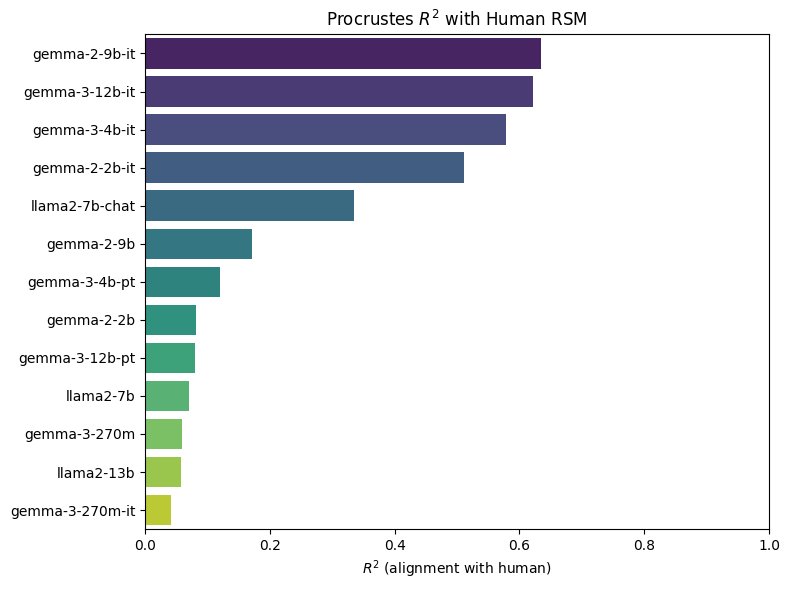

              model        R2
3     gemma-2-9b-it  0.633781
6    gemma-3-12b-it  0.621459
4     gemma-3-4b-it  0.577902
1     gemma-2-2b-it  0.511435
11   llama2-7b-chat  0.334108
2        gemma-2-9b  0.170681
5     gemma-3-4b-pt  0.119092
0        gemma-2-2b  0.080888
7    gemma-3-12b-pt  0.079230
10        llama2-7b  0.069802
8      gemma-3-270m  0.058320
12       llama2-13b  0.057068
9   gemma-3-270m-it  0.041857


In [47]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# --- Extract human vs model comparisons ---
human_r2 = []
for model in r2_rsm_df.columns:
    if model != "human":
        human_r2.append({
            "model": model,
            "R2": r2_rsm_df.loc["human", model]
        })

df_human = pd.DataFrame(human_r2).sort_values("R2", ascending=False)

# --- Plot ---
plt.figure(figsize=(8, 6))
sns.barplot(data=df_human, x="R2", y="model", palette="viridis")
plt.title("Procrustes $R^2$ with Human RSM")
plt.xlabel("$R^2$ (alignment with human)")
plt.ylabel("")
plt.xlim(0, 1)
plt.tight_layout()
plt.show()

print(df_human)


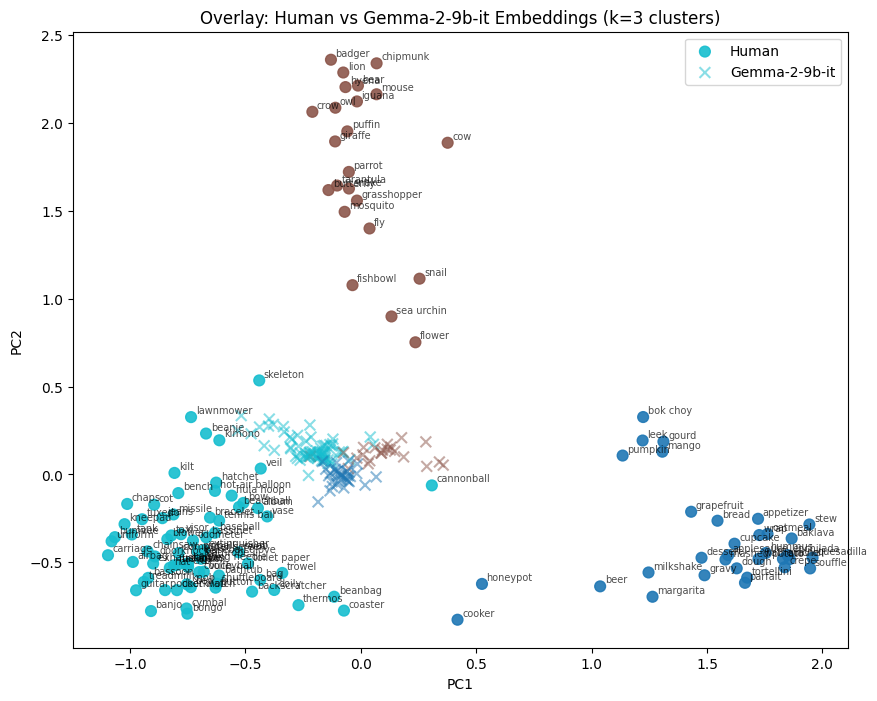

In [48]:
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# --- Extract features ---
X_human = embed_human.filter(like="dim_").values
X_model = embed_gemma_2_9b_it.filter(like="dim_").values

# --- Ensure same items & alignment ---
shared = sorted(set(embed_human["item"]).intersection(embed_gemma_2_9b_it["item"]))
human_df = embed_human[embed_human["item"].isin(shared)].sort_values("item").reset_index(drop=True)
model_df = embed_gemma_2_9b_it[embed_gemma_2_9b_it["item"].isin(shared)].sort_values("item").reset_index(drop=True)

X_human = human_df.filter(like="dim_").values
X_model = model_df.filter(like="dim_").values

# --- KMeans on human embeddings ---
kmeans = KMeans(n_clusters=3, random_state=42, n_init="auto").fit(X_human)
labels = kmeans.labels_
human_df["cluster"] = labels

# --- PCA trained on human embeddings, project both sets ---
pca = PCA(n_components=2, random_state=42)
X_human_pca = pca.fit_transform(X_human)
X_model_pca = pca.transform(X_model)  # project model into same PCA space

# --- Plot ---
plt.figure(figsize=(10,8))

# Humans (colored by cluster)
plt.scatter(X_human_pca[:,0], X_human_pca[:,1],
            c=labels, cmap="tab10", s=60, alpha=0.9, label="Human")

# Model embeddings (gray markers, same items, overlayed)
plt.scatter(X_model_pca[:,0], X_model_pca[:,1],
            c=labels, cmap="tab10", s=60, alpha=0.5, marker="x", label="Gemma-2-9b-it")

plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title("Overlay: Human vs Gemma-2-9b-it Embeddings (k=3 clusters)")
plt.legend()

# Optionally label items
for i, txt in enumerate(human_df["item"]):
    plt.text(X_human_pca[i,0]+0.02, X_human_pca[i,1]+0.02, txt, fontsize=7, alpha=0.7)

plt.show()


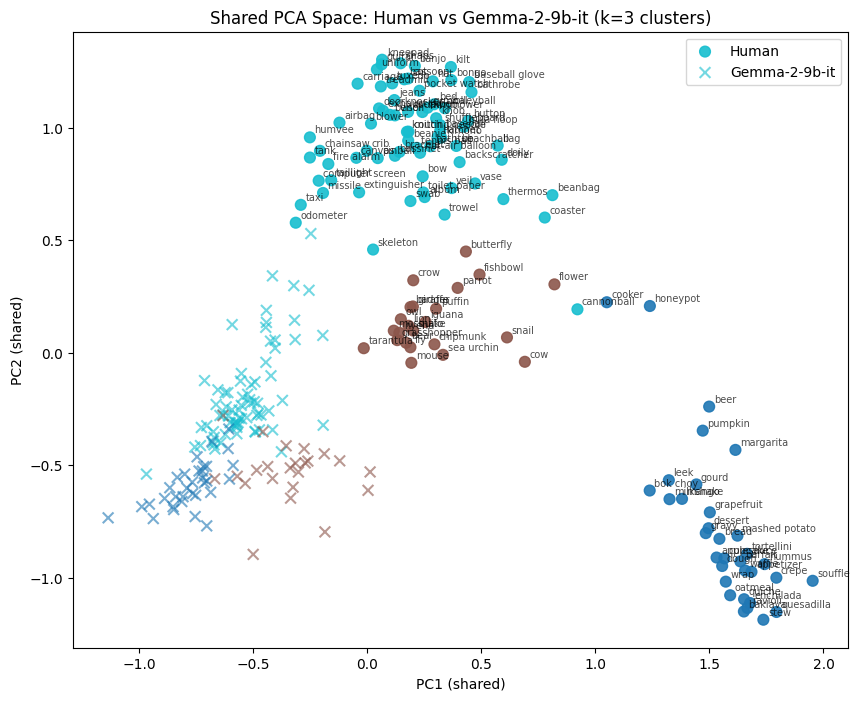

In [50]:
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# --- Align shared items ---
shared = sorted(set(embed_human["item"]).intersection(embed_gemma_2_9b_it["item"]))
human_df = embed_human[embed_human["item"].isin(shared)].sort_values("item").reset_index(drop=True)
model_df = embed_gemma_2_9b_it[embed_gemma_2_9b_it["item"].isin(shared)].sort_values("item").reset_index(drop=True)

X_human = human_df.filter(like="dim_").values
X_model = model_df.filter(like="dim_").values

# --- KMeans on human embeddings (clusters) ---
kmeans = KMeans(n_clusters=3, random_state=42, n_init="auto").fit(X_human)
labels = kmeans.labels_
human_df["cluster"] = labels

# --- PCA on combined embeddings for shared space ---
X_combined = np.vstack([X_human, X_model])
pca = PCA(n_components=2, random_state=42)
X_combined_pca = pca.fit_transform(X_combined)

# Split back into human / model
X_human_pca = X_combined_pca[:len(X_human)]
X_model_pca = X_combined_pca[len(X_human):]

# --- Plot overlay ---
plt.figure(figsize=(10, 8))

# Humans (circles, colored by cluster)
plt.scatter(X_human_pca[:, 0], X_human_pca[:, 1],
            c=labels, cmap="tab10", s=60, alpha=0.9, label="Human")

# Model embeddings (crosses, same items, same PCA space)
plt.scatter(X_model_pca[:, 0], X_model_pca[:, 1],
            c=labels, cmap="tab10", s=60, alpha=0.6, marker="x", label="Gemma-2-9b-it")

plt.xlabel("PC1 (shared)")
plt.ylabel("PC2 (shared)")
plt.title("Shared PCA Space: Human vs Gemma-2-9b-it (k=3 clusters)")
plt.legend()

# Optional text labels for items
for i, txt in enumerate(human_df["item"]):
    plt.text(X_human_pca[i,0] + 0.02, X_human_pca[i,1] + 0.02, txt, fontsize=7, alpha=0.7)

plt.show()


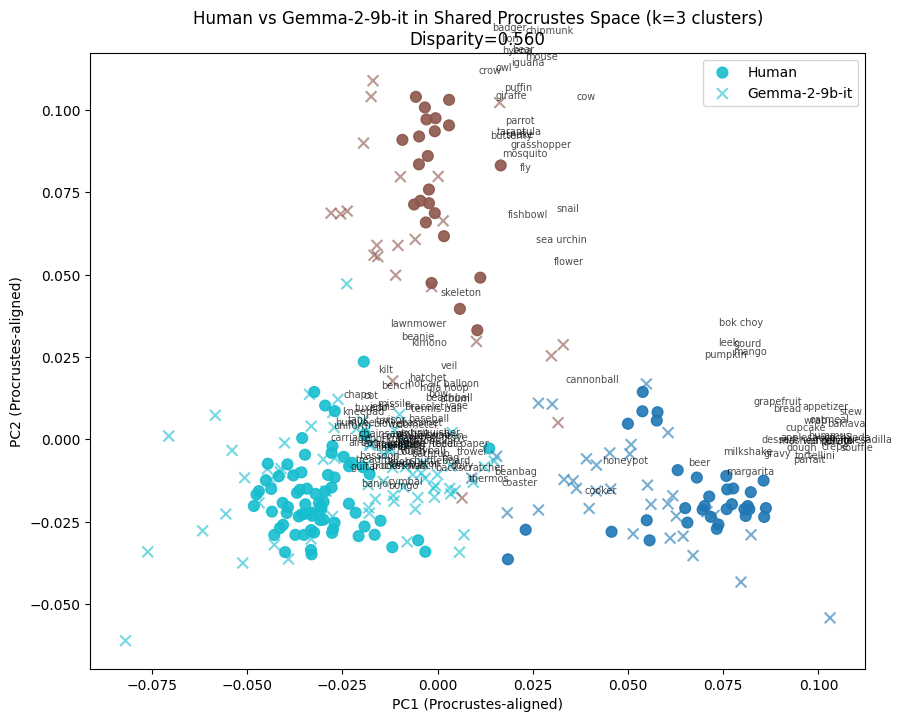

In [51]:
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from scipy.spatial import procrustes

# --- Align shared items ---
shared = sorted(set(embed_human["item"]).intersection(embed_gemma_2_9b_it["item"]))
human_df = embed_human[embed_human["item"].isin(shared)].sort_values("item").reset_index(drop=True)
model_df = embed_gemma_2_9b_it[embed_gemma_2_9b_it["item"].isin(shared)].sort_values("item").reset_index(drop=True)

X_human = human_df.filter(like="dim_").values
X_model = model_df.filter(like="dim_").values

# --- KMeans on human embeddings (clusters) ---
kmeans = KMeans(n_clusters=3, random_state=42, n_init="auto").fit(X_human)
labels = kmeans.labels_
human_df["cluster"] = labels

# --- Procrustes alignment (rotates/scales/centers model to match human) ---
mtx1, mtx2, disparity = procrustes(X_human, X_model)

# --- PCA for 2D visualization ---
pca = PCA(n_components=2, random_state=42)
X_human_pca = pca.fit_transform(mtx1)
X_model_pca = pca.transform(mtx2)   # project aligned model into same PCA basis

# --- Plot overlay ---
plt.figure(figsize=(10, 8))

# Human embeddings (circles, colored by cluster)
plt.scatter(X_human_pca[:, 0], X_human_pca[:, 1],
            c=labels, cmap="tab10", s=60, alpha=0.9, label="Human")

# Model embeddings (crosses, same items, Procrustes aligned)
plt.scatter(X_model_pca[:, 0], X_model_pca[:, 1],
            c=labels, cmap="tab10", s=60, alpha=0.6, marker="x", label="Gemma-2-9b-it")

plt.xlabel("PC1 (Procrustes-aligned)")
plt.ylabel("PC2 (Procrustes-aligned)")
plt.title(f"Human vs Gemma-2-9b-it in Shared Procrustes Space (k=3 clusters)\nDisparity={disparity:.3f}")
plt.legend()

# Optional: item labels
for i, txt in enumerate(human_df["item"]):
    plt.text(X_human_pca[i,0]+0.02, X_human_pca[i,1]+0.02, txt, fontsize=7, alpha=0.7)

plt.show()


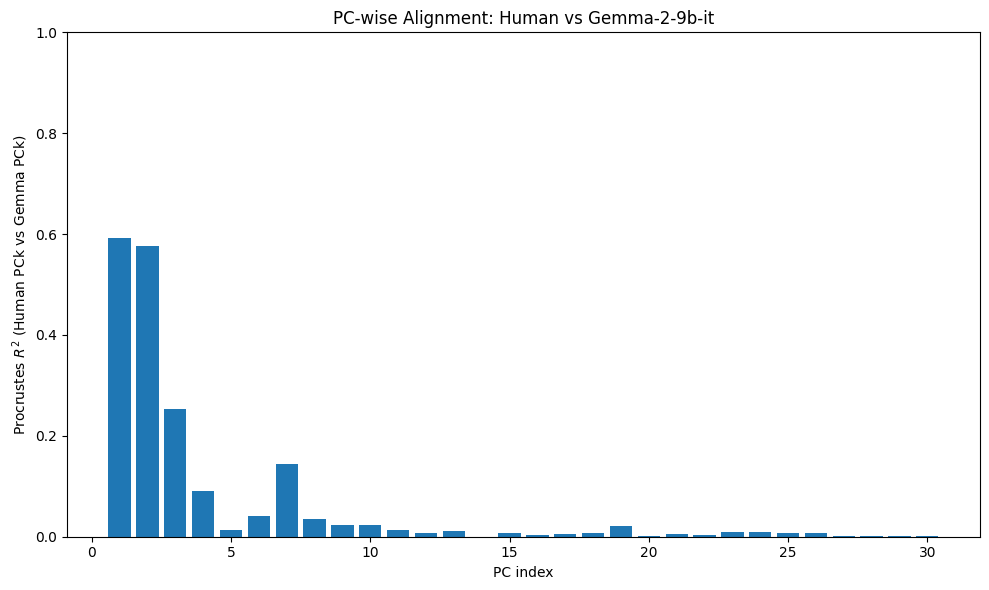

    PC        R2
0    1  0.592719
1    2  0.576724
2    3  0.254105
3    4  0.090033
4    5  0.012409
5    6  0.040346
6    7  0.144092
7    8  0.035696
8    9  0.023355
9   10  0.023722
10  11  0.013072
11  12  0.007543
12  13  0.011524
13  14  0.000094
14  15  0.006658
15  16  0.003124
16  17  0.004984
17  18  0.007993
18  19  0.020447
19  20  0.002195


In [57]:
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from scipy.spatial import procrustes
import matplotlib.pyplot as plt

# --- Helper: Procrustes R² (works for 1D too) ---
def procrustes_r2_spatial(x, y):
    # reshape to 2D if 1D
    if x.ndim == 1:
        x = x[:, None]
    if y.ndim == 1:
        y = y[:, None]
    _, _, disparity = procrustes(x, y)
    return float(np.clip(1 - disparity, 0.0, 1.0))

# --- Align shared items ---
shared = sorted(set(embed_human["item"]).intersection(embed_gemma_2_9b_it["item"]))
human_df = embed_human[embed_human["item"].isin(shared)].sort_values("item").reset_index(drop=True)
model_df = embed_gemma_2_9b_it[embed_gemma_2_9b_it["item"].isin(shared)].sort_values("item").reset_index(drop=True)

X_human = human_df.filter(like="dim_").values
X_model = model_df.filter(like="dim_").values

# --- PCA separately on each space ---
pca_h = PCA(n_components=min(200, X_human.shape[1]), random_state=42).fit(X_human)
pca_m = PCA(n_components=min(200, X_model.shape[1]), random_state=42).fit(X_model)

X_h_pca = pca_h.transform(X_human)
X_m_pca = pca_m.transform(X_model)

# --- Compute R² per PC (human PCk vs model PCk) ---
n_comps = min(X_h_pca.shape[1], X_m_pca.shape[1])
pc_r2 = []
for k in range(n_comps):
    r2 = procrustes_r2_spatial(X_h_pca[:, k], X_m_pca[:, k])
    pc_r2.append(r2)

# --- Plot ---
plt.figure(figsize=(10, 6))
plt.bar(range(1, n_comps+1), pc_r2, color="tab:blue")
plt.xlabel("PC index")
plt.ylabel("Procrustes $R^2$ (Human PCk vs Gemma PCk)")
plt.title("PC-wise Alignment: Human vs Gemma-2-9b-it")
plt.ylim(0, 1)
plt.tight_layout()
plt.show()

# --- DataFrame output ---
pc_r2_df = pd.DataFrame({"PC": range(1, n_comps+1), "R2": pc_r2})
print(pc_r2_df.head(20))  # first 20 PCs


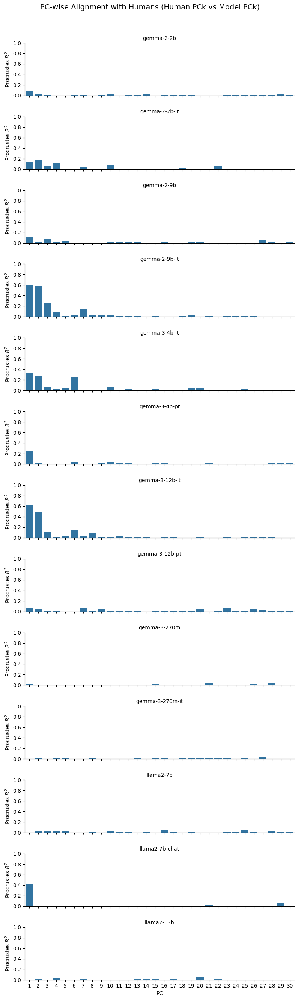

In [60]:
# --- Row-faceted barplots (one model per row) ---
g = sns.FacetGrid(df_results, row="Model", sharex=True, sharey=True, height=2, aspect=4)
g.map_dataframe(sns.barplot, x="PC", y="R2", color="tab:blue")

# formatting
g.set_titles("{row_name}")
for ax in g.axes.flatten():
    ax.set_ylim(0, 1)
    ax.set_xlabel("PC")
    ax.set_ylabel("Procrustes $R^2$")

plt.subplots_adjust(top=0.98, hspace=0.4)
g.fig.suptitle("PC-wise Alignment with Humans (Human PCk vs Model PCk)", fontsize=14, y=1.02)
plt.show()


/tmp/ipykernel_3717328/2321911783.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df_human, x="inv_disparity", y="model", palette="viridis")


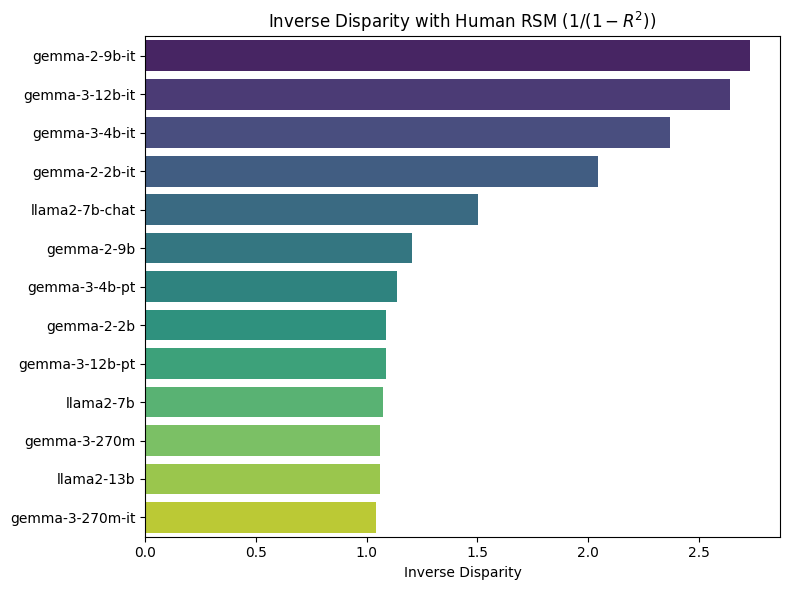

              model        R2  inv_disparity
3     gemma-2-9b-it  0.633781       2.730610
6    gemma-3-12b-it  0.621459       2.641719
4     gemma-3-4b-it  0.577902       2.369119
1     gemma-2-2b-it  0.511435       2.046812
11   llama2-7b-chat  0.334108       1.501746
2        gemma-2-9b  0.170681       1.205809
5     gemma-3-4b-pt  0.119092       1.135193
0        gemma-2-2b  0.080888       1.088007
7    gemma-3-12b-pt  0.079230       1.086048
10        llama2-7b  0.069802       1.075039
8      gemma-3-270m  0.058320       1.061932
12       llama2-13b  0.057068       1.060522
9   gemma-3-270m-it  0.041857       1.043685


In [61]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# --- Extract human vs model comparisons and compute inverse disparity ---
human_r2 = []
for model in r2_rsm_df.columns:
    if model != "human":
        r2 = r2_rsm_df.loc["human", model]
        disparity = 1 - r2
        inv_disparity = 1 / disparity if disparity > 0 else float('inf')
        human_r2.append({
            "model": model,
            "R2": r2,
            "inv_disparity": inv_disparity
        })

df_human = pd.DataFrame(human_r2).sort_values("inv_disparity", ascending=False)

# --- Plot ---
plt.figure(figsize=(8, 6))
sns.barplot(data=df_human, x="inv_disparity", y="model", palette="viridis")
plt.title("Inverse Disparity with Human RSM ($1 / (1 - R^2)$)")
plt.xlabel("Inverse Disparity")
plt.ylabel("")
plt.tight_layout()
plt.show()

print(df_human)


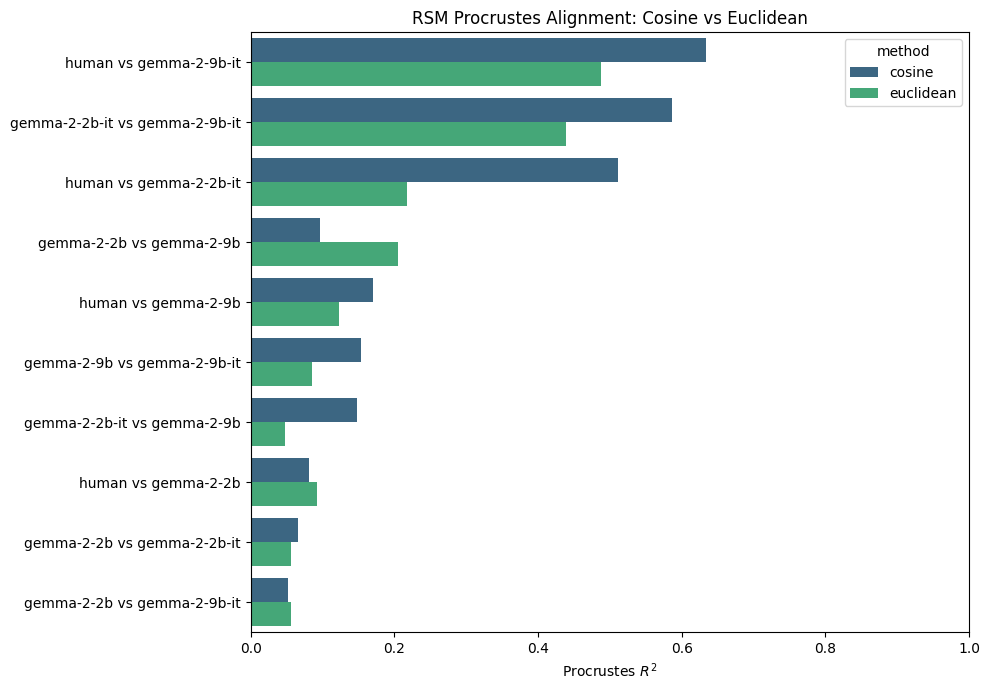

In [80]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
from scipy.spatial import distance, procrustes

# --- Helper: Procrustes R² ---
def procrustes_r2_spatial(X, Y):
    _, _, disparity = procrustes(X, Y)
    return float(np.clip(1 - disparity, 0.0, 1.0))

# --- Embedding sets ---
embeddings_dict = {
    "human": embed_human,
    "gemma-2-2b": embed_gemma_2_2b,
    "gemma-2-2b-it": embed_gemma_2_2b_it,
    "gemma-2-9b": embed_gemma_2_9b,
    "gemma-2-9b-it": embed_gemma_2_9b_it,
}
names = list(embeddings_dict.keys())
n = len(names)

# --- RSMs using cosine and euclidean ---
def compute_rsm(df, metric):
    X = df.filter(like="dim_").values
    if metric == "cosine":
        return cosine_similarity(X)
    elif metric == "euclidean":
        return -distance.squareform(distance.pdist(X, metric="euclidean"))  # negative = similarity

def get_shared(df1, df2):
    shared_items = sorted(set(df1["item"]).intersection(df2["item"]))
    A = df1[df1["item"].isin(shared_items)].sort_values("item")
    B = df2[df2["item"].isin(shared_items)].sort_values("item")
    return A, B

def build_r2_matrix(metric):
    M = np.eye(n)
    for i in range(n):
        for j in range(i + 1, n):
            A, B = get_shared(embeddings_dict[names[i]], embeddings_dict[names[j]])
            rsm_A = compute_rsm(A, metric)
            rsm_B = compute_rsm(B, metric)
            r2 = procrustes_r2_spatial(rsm_A, rsm_B)
            M[i, j] = M[j, i] = r2
    return pd.DataFrame(M, index=names, columns=names)

# --- Compute both matrices ---
r2_cosine_df = build_r2_matrix("cosine")
r2_euclid_df = build_r2_matrix("euclidean")

# --- Flatten and sort ---
def melt_r2(r2_df, label):
    pairs = []
    for i in range(len(r2_df)):
        for j in range(i + 1, len(r2_df)):
            pairs.append({
                "pair": f"{r2_df.index[i]} vs {r2_df.columns[j]}",
                "R2": r2_df.iloc[i, j],
                "method": label
            })
    return pd.DataFrame(pairs)

df_long = pd.concat([
    melt_r2(r2_cosine_df, "cosine"),
    melt_r2(r2_euclid_df, "euclidean")
])

# --- Plot ---
plt.figure(figsize=(10, 7))
sns.barplot(data=df_long.sort_values("R2", ascending=False), x="R2", y="pair", hue="method", palette="viridis")
plt.xlabel("Procrustes $R^2$")
plt.ylabel("")
plt.title("RSM Procrustes Alignment: Cosine vs Euclidean")
plt.xlim(0, 1)
plt.tight_layout()
plt.show()


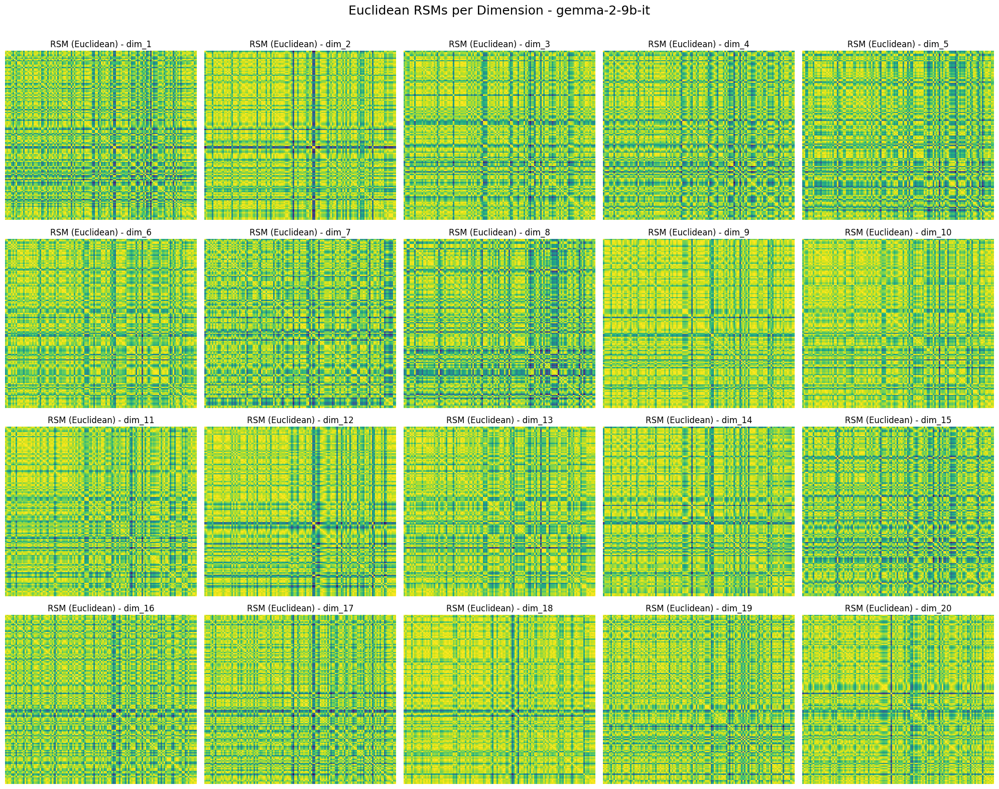

In [81]:
# Re-import necessary packages after kernel reset
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.spatial import distance

# Reload gemma-2-9b-it embeddings
embed_gemma_2_9b_it = pd.read_csv("../results/1a/embed_out/gemma-2-9b-it/embeddings_gemma-2-9b-it.csv")

# Extract just the embeddings (no item column)
X = embed_gemma_2_9b_it.filter(like="dim_").values
item_labels = embed_gemma_2_9b_it["item"].values

# Prepare figure for 20 RSMs (one per dimension)
fig, axes = plt.subplots(4, 5, figsize=(20, 16))
axes = axes.flatten()

# Loop through 20 dimensions
for dim in range(20):
    # Extract 1D vector and reshape to Nx1 to allow pdist
    X_dim = X[:, dim].reshape(-1, 1)
    dist_matrix = distance.squareform(distance.pdist(X_dim, metric="euclidean"))
    sim_matrix = -dist_matrix  # convert to similarity for plotting

    ax = axes[dim]
    sns.heatmap(sim_matrix, ax=ax, cmap="viridis", cbar=False, xticklabels=False, yticklabels=False)
    ax.set_title(f"RSM (Euclidean) - dim_{dim+1}")

plt.suptitle("Euclidean RSMs per Dimension - gemma-2-9b-it", fontsize=18)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()


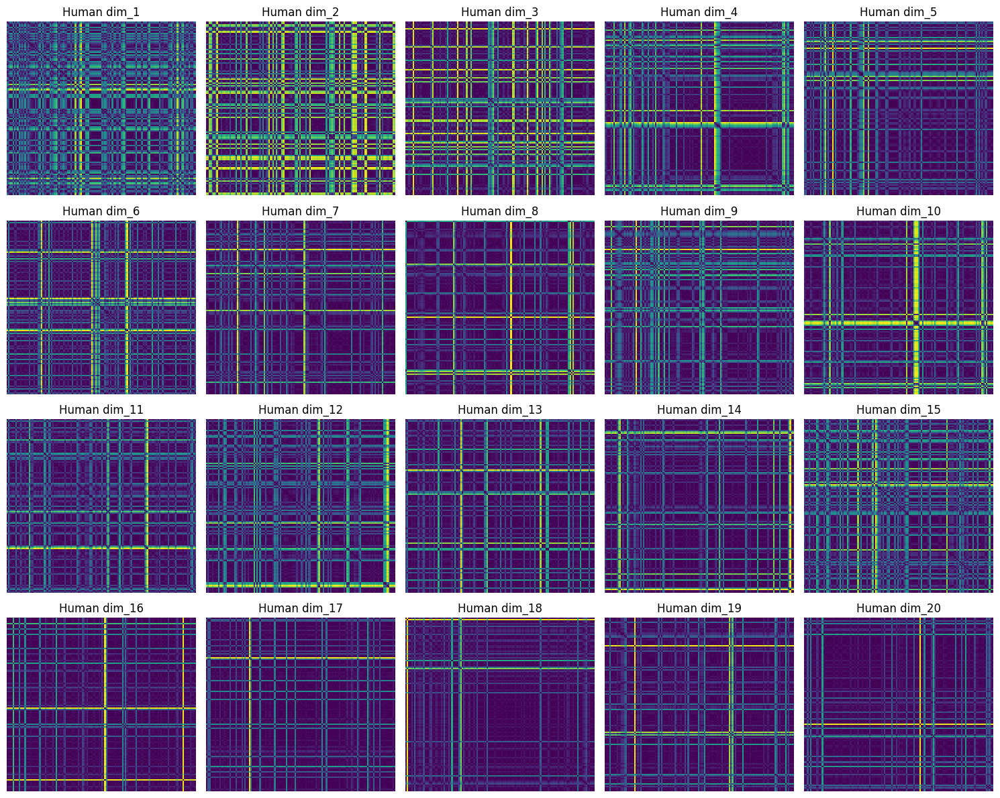

In [86]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import pairwise_distances

# --- Extract values ---
X_human = embed_human.filter(like="dim_").values

# --- Plot Euclidean RSMs for first 20 dimensions ---
fig, axes = plt.subplots(4, 5, figsize=(15, 12))
axes = axes.flatten()

for i in range(20):
    x = X_human[:, i].reshape(-1, 1)
    rsm = pairwise_distances(x, metric="euclidean")
    sns.heatmap(rsm, ax=axes[i], cmap="viridis", cbar=False)
    axes[i].set_title(f"Human dim_{i+1}")
    axes[i].axis("off")

plt.tight_layout()
plt.show()


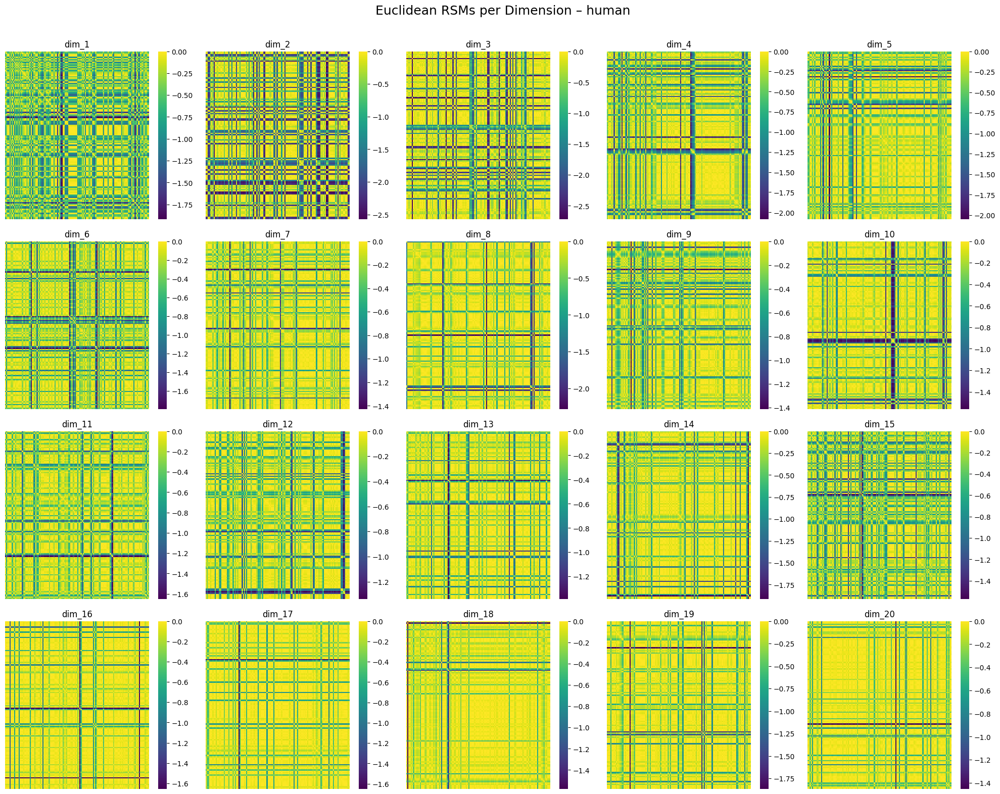

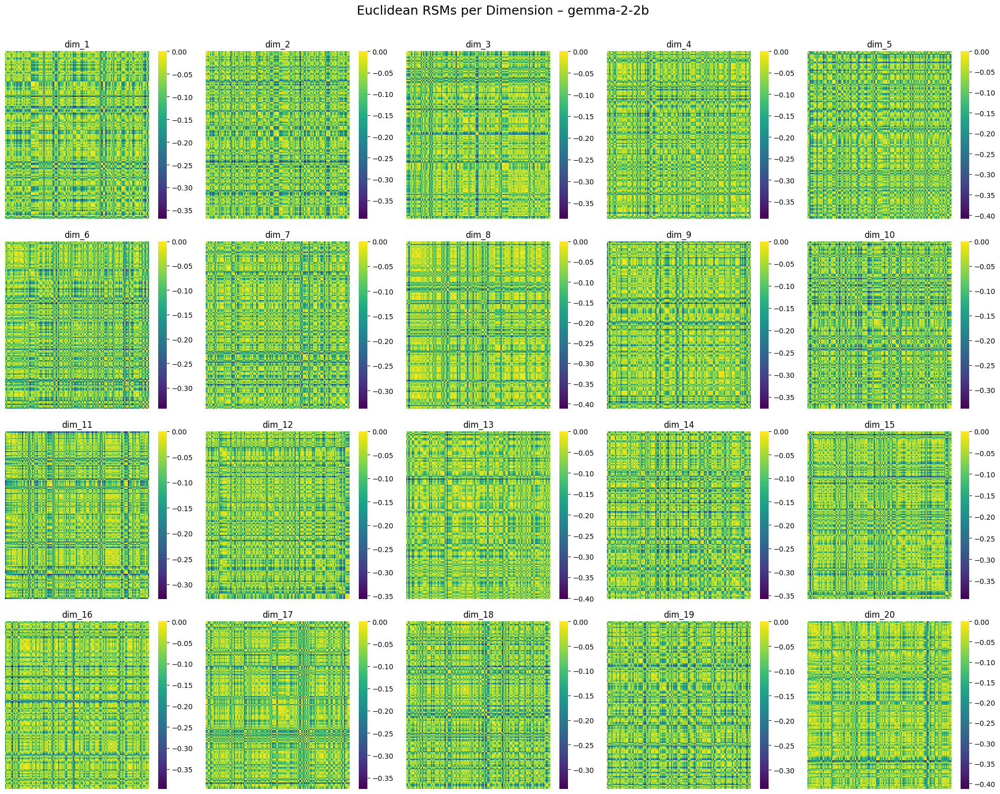

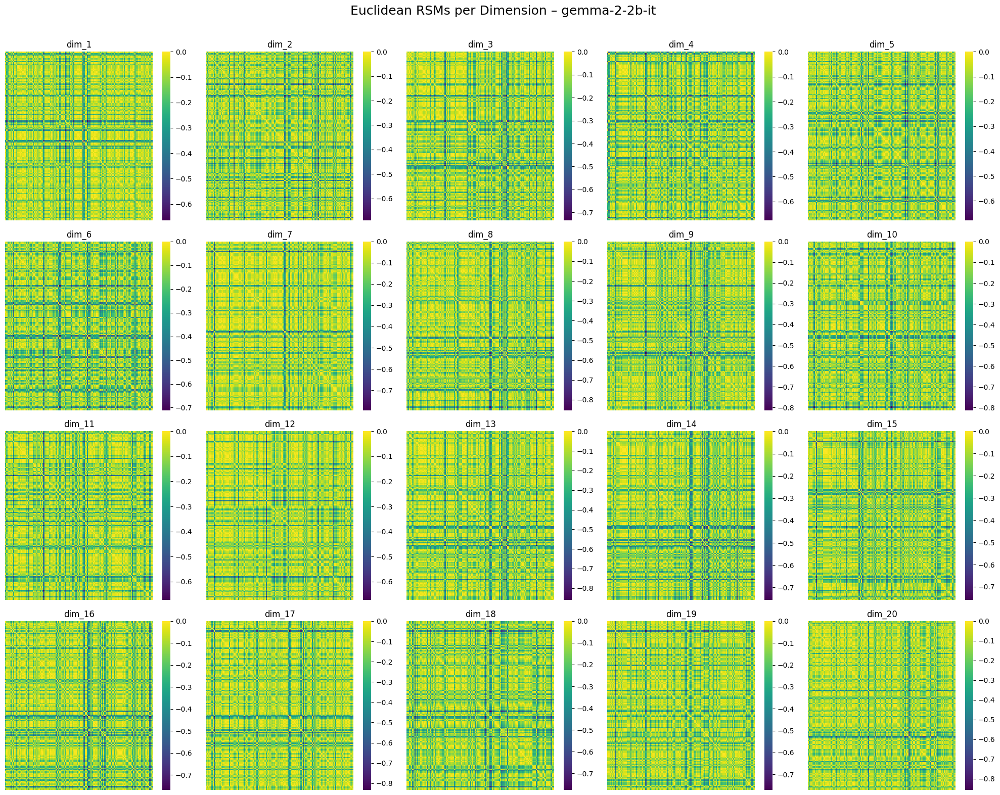

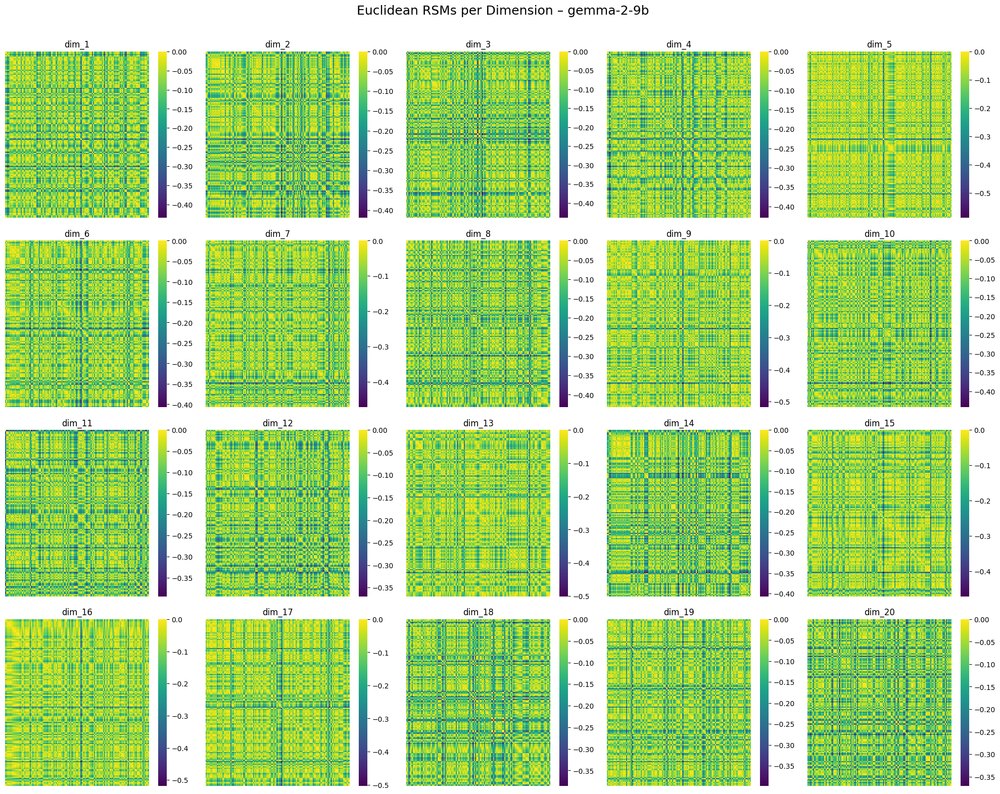

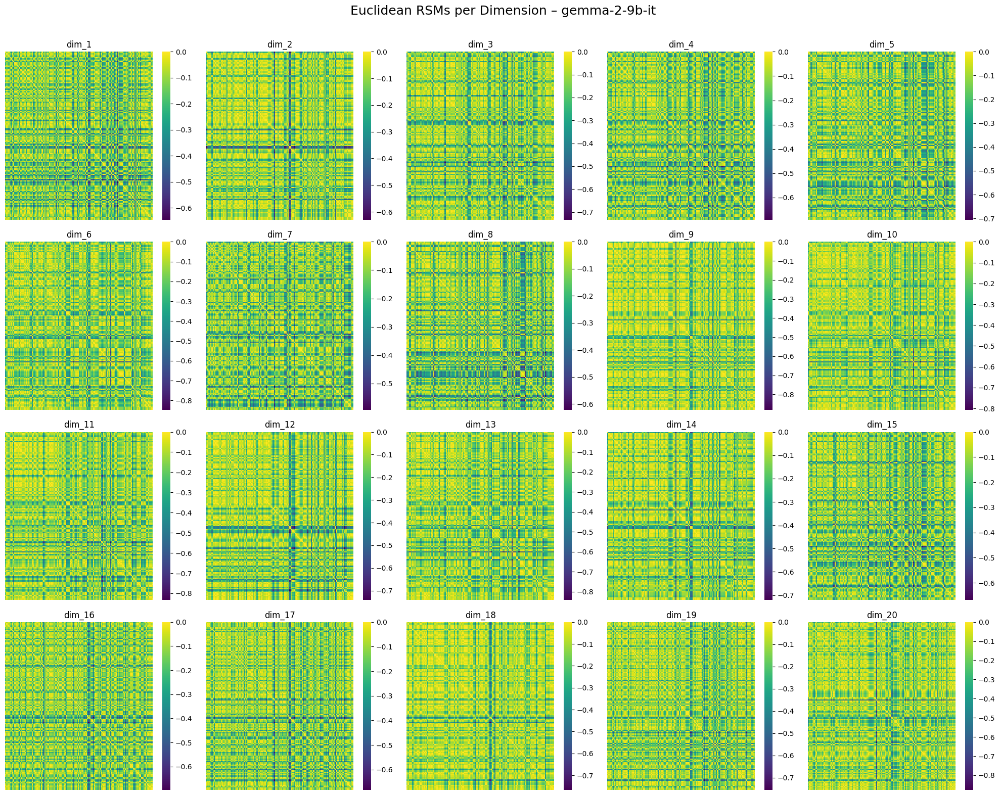

...

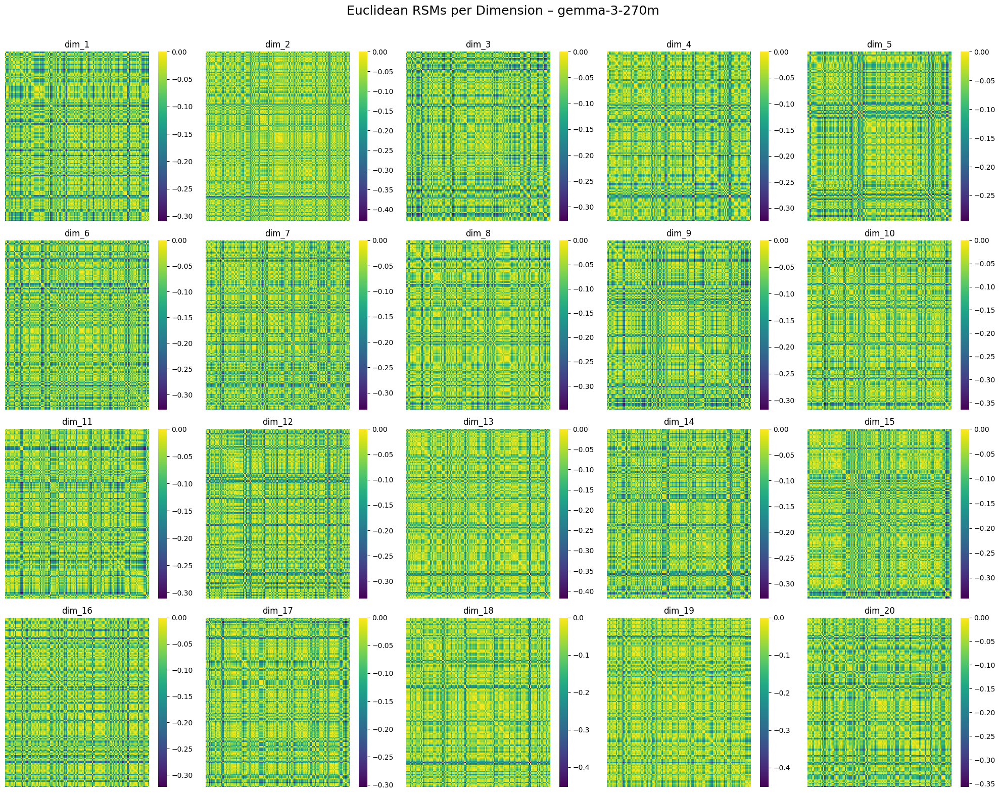

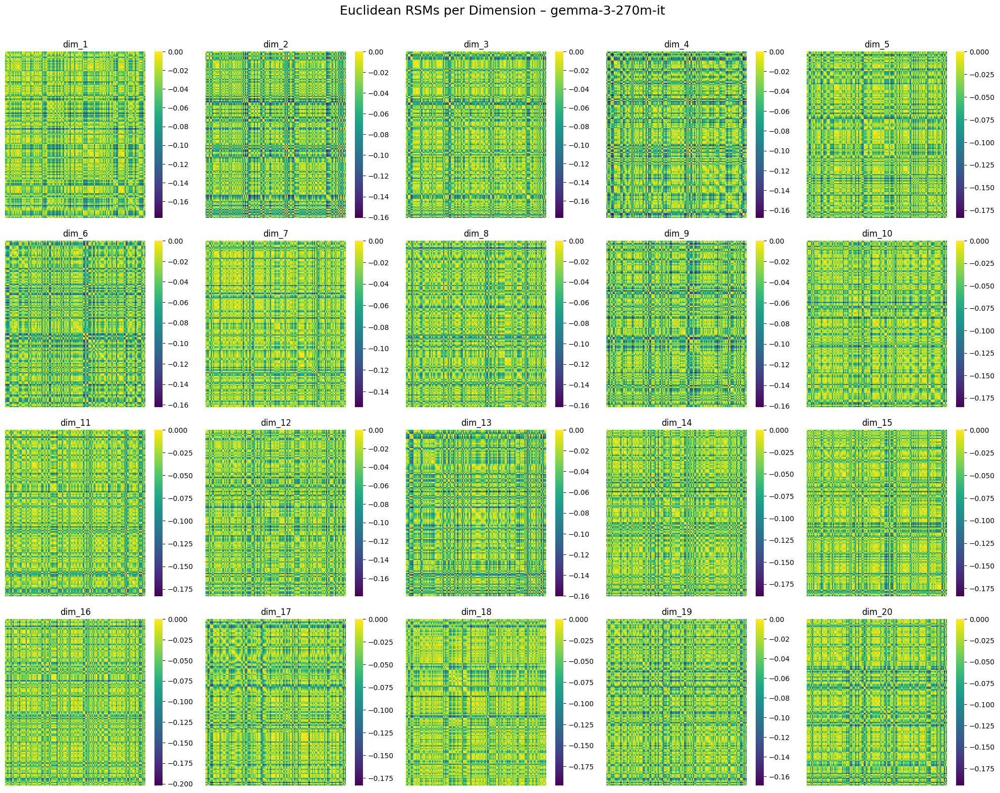

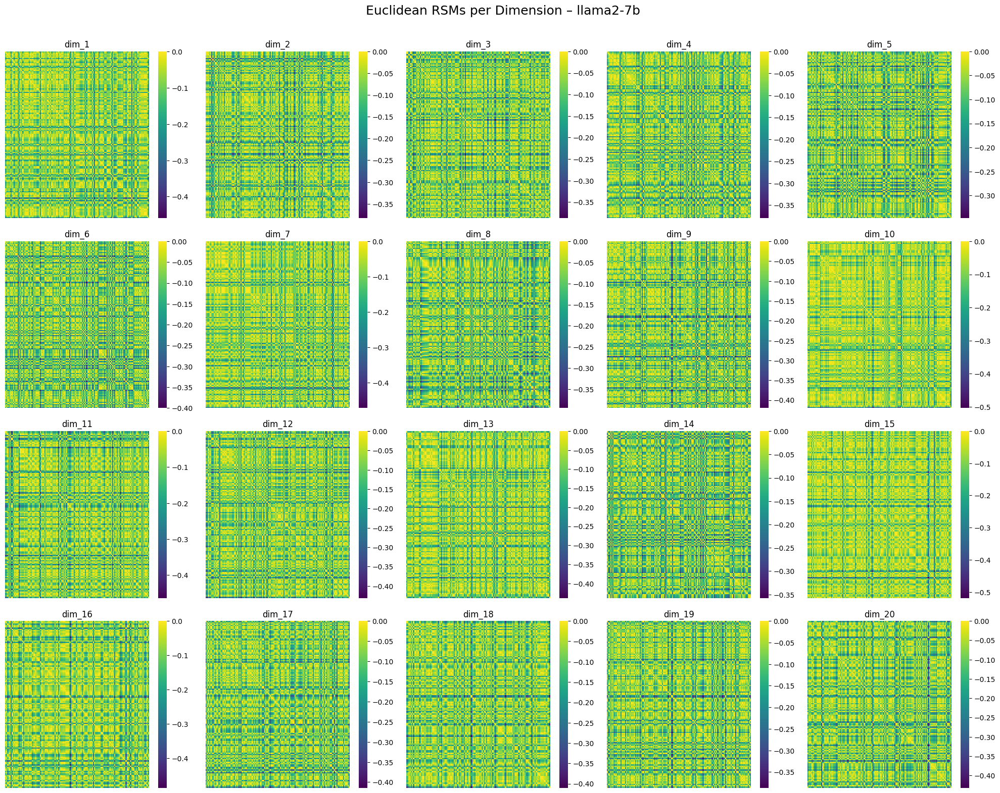

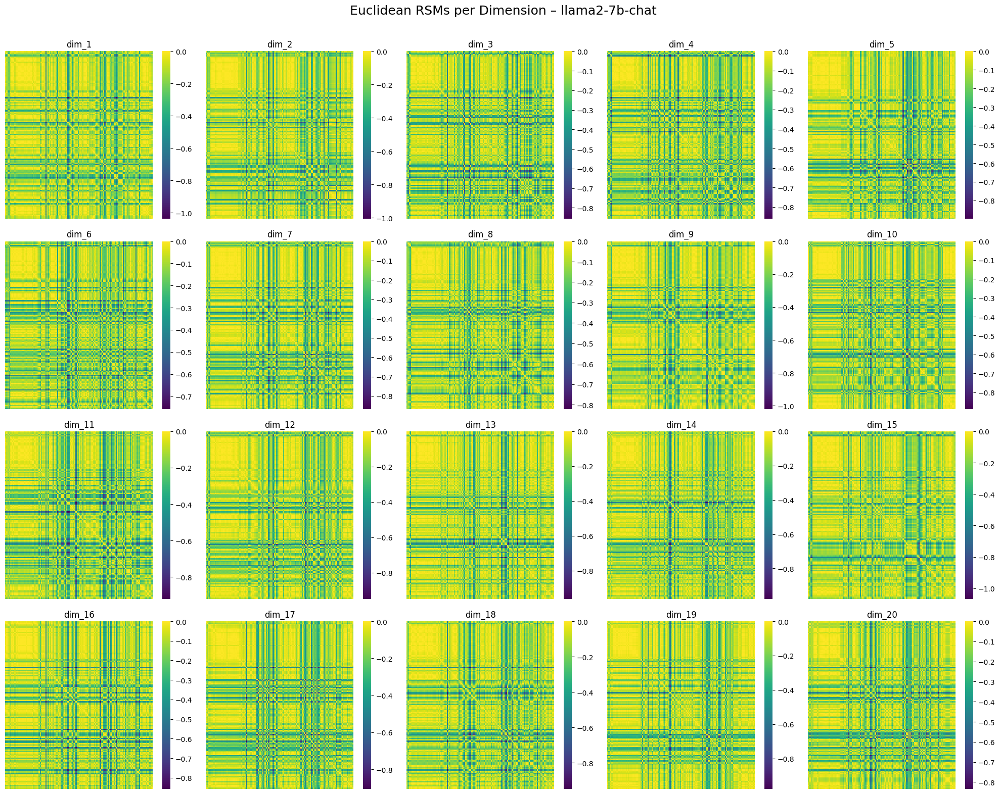

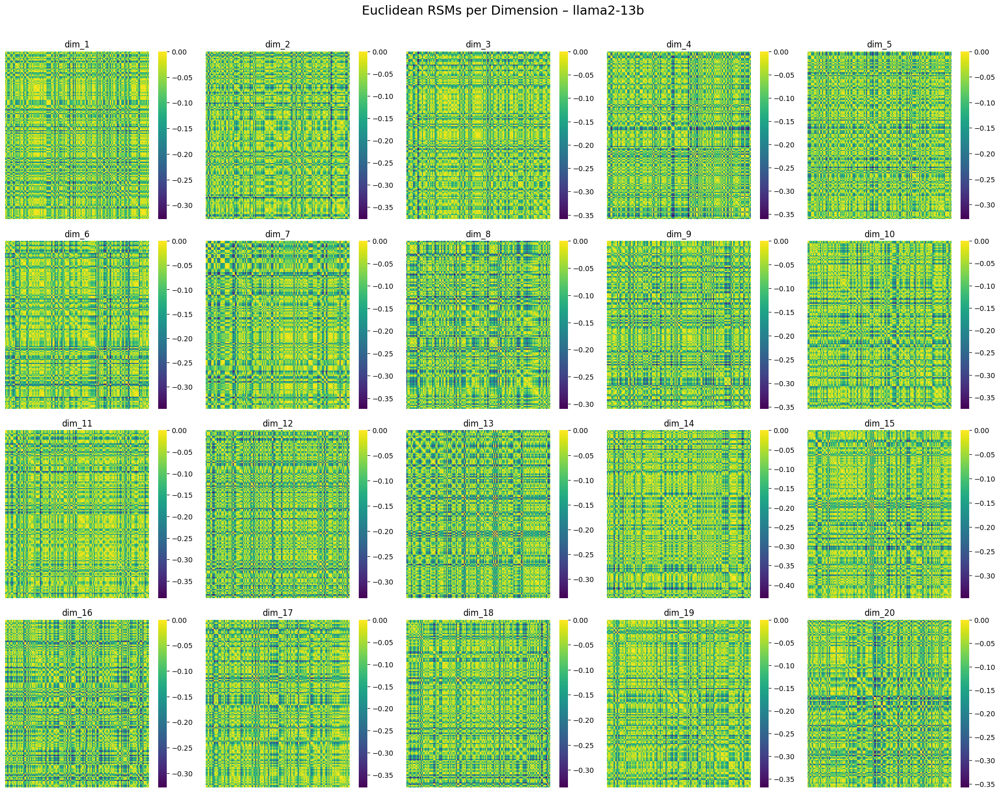

In [88]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.spatial import distance

# --- Dictionary of model embeddings ---
model_dict = {
    "human": embed_human,
    "gemma-2-2b": embed_gemma_2_2b,
    "gemma-2-2b-it": embed_gemma_2_2b_it,
    "gemma-2-9b": embed_gemma_2_9b,
    "gemma-2-9b-it": embed_gemma_2_9b_it,
    "gemma-3-4b-it": embed_gemma_3_4b_it,
    "gemma-3-4b-pt": embed_gemma_3_4b_pt,
    "gemma-3-12b-it": embed_gemma_3_12b_it,
    "gemma-3-12b-pt": embed_gemma_3_12b_pt,
    "gemma-3-270m": embed_gemma_3_270m,
    "gemma-3-270m-it": embed_gemma_3_270m_it,
    "llama2-7b": embed_llama2_7b,
    "llama2-7b-chat": embed_llama2_7b_chat,
    "llama2-13b": embed_llama2_13b,
}

# --- Loop through models ---
for model_name, df in model_dict.items():
    X = df.filter(like="dim_").values

    fig, axes = plt.subplots(4, 5, figsize=(20, 16))
    axes = axes.flatten()

    for dim in range(20):
        X_dim = X[:, dim].reshape(-1, 1)
        dist_matrix = distance.squareform(distance.pdist(X_dim, metric="euclidean"))
        sim_matrix = -dist_matrix  # convert to similarity for visualization

        ax = axes[dim]
        sns.heatmap(
            sim_matrix,
            ax=ax,
            cmap="viridis",
            cbar=True,  # show the legend
            xticklabels=False,
            yticklabels=False
        )
        ax.set_title(f"dim_{dim+1}")

    plt.suptitle(f"Euclidean RSMs per Dimension – {model_name}", fontsize=18)
    plt.tight_layout(rect=[0, 0, 1, 0.97])
    plt.show()


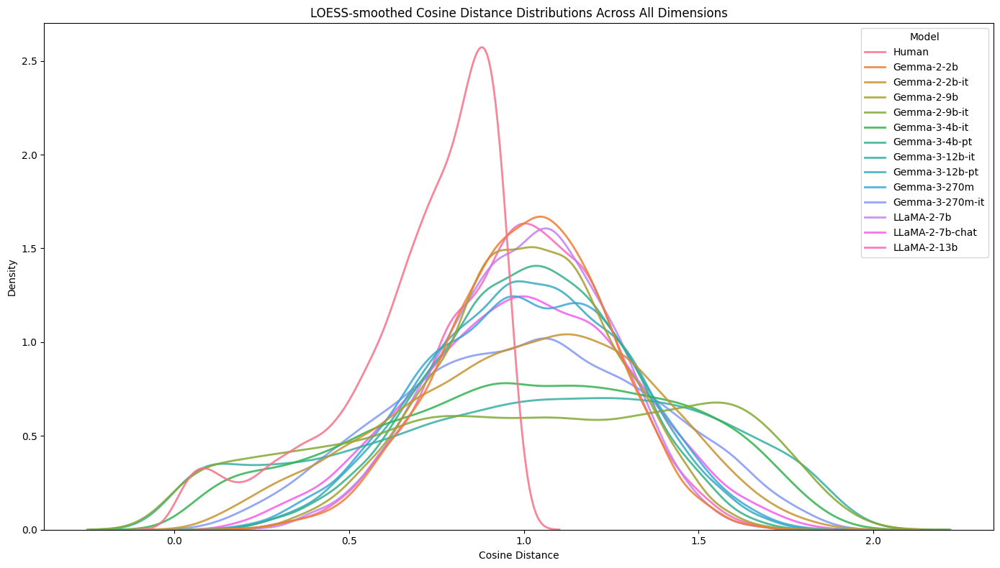

In [91]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.spatial.distance import pdist

# --- Model label → dataframe mapping ---
model_dfs = {
    "Human": embed_human,
    "Gemma-2-2b": embed_gemma_2_2b,
    "Gemma-2-2b-it": embed_gemma_2_2b_it,
    "Gemma-2-9b": embed_gemma_2_9b,
    "Gemma-2-9b-it": embed_gemma_2_9b_it,
    "Gemma-3-4b-it": embed_gemma_3_4b_it,
    "Gemma-3-4b-pt": embed_gemma_3_4b_pt,
    "Gemma-3-12b-it": embed_gemma_3_12b_it,
    "Gemma-3-12b-pt": embed_gemma_3_12b_pt,
    "Gemma-3-270m": embed_gemma_3_270m,
    "Gemma-3-270m-it": embed_gemma_3_270m_it,
    "LLaMA-2-7b": embed_llama2_7b,
    "LLaMA-2-7b-chat": embed_llama2_7b_chat,
    "LLaMA-2-13b": embed_llama2_13b,
}

# --- Compute cosine distances for each ---
distance_data = []

for model_name, df in model_dfs.items():
    X = df.filter(like="dim_").values
    dists = pdist(X, metric="cosine")
    distance_data.append(pd.DataFrame({
        "Distance": dists,
        "Model": model_name
    }))

# --- Combine into one DataFrame ---
all_distances = pd.concat(distance_data, ignore_index=True)

# --- Plot KDE (LOESS-style) ---
plt.figure(figsize=(14, 8))
sns.kdeplot(
    data=all_distances,
    x="Distance",
    hue="Model",
    common_norm=False,
    linewidth=2,
    fill=False,
    alpha=0.85
)
plt.title("LOESS-smoothed Cosine Distance Distributions Across All Dimensions")
plt.xlabel("Cosine Distance")
plt.ylabel("Density")
plt.tight_layout()
plt.show()


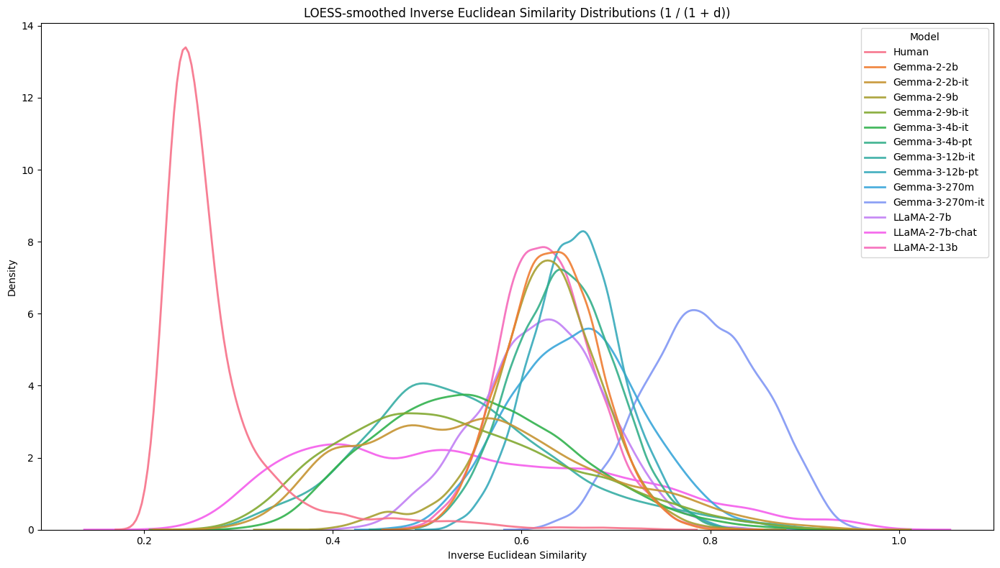

In [93]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.spatial.distance import pdist

# --- Model label → dataframe mapping ---
model_dfs = {
    "Human": embed_human,
    "Gemma-2-2b": embed_gemma_2_2b,
    "Gemma-2-2b-it": embed_gemma_2_2b_it,
    "Gemma-2-9b": embed_gemma_2_9b,
    "Gemma-2-9b-it": embed_gemma_2_9b_it,
    "Gemma-3-4b-it": embed_gemma_3_4b_it,
    "Gemma-3-4b-pt": embed_gemma_3_4b_pt,
    "Gemma-3-12b-it": embed_gemma_3_12b_it,
    "Gemma-3-12b-pt": embed_gemma_3_12b_pt,
    "Gemma-3-270m": embed_gemma_3_270m,
    "Gemma-3-270m-it": embed_gemma_3_270m_it,
    "LLaMA-2-7b": embed_llama2_7b,
    "LLaMA-2-7b-chat": embed_llama2_7b_chat,
    "LLaMA-2-13b": embed_llama2_13b,
}

# --- Compute inverse Euclidean similarities ---
distance_data = []

for model_name, df in model_dfs.items():
    X = df.filter(like="dim_").values
    dists = pdist(X, metric="euclidean")
    inverse_sims = 1 / (1 + dists)
    distance_data.append(pd.DataFrame({
        "InverseSimilarity": inverse_sims,
        "Model": model_name
    }))

# --- Combine all ---
all_similarities = pd.concat(distance_data, ignore_index=True)

# --- Plot ---
plt.figure(figsize=(14, 8))
sns.kdeplot(
    data=all_similarities,
    x="InverseSimilarity",
    hue="Model",
    common_norm=False,
    linewidth=2,
    fill=False,
    alpha=0.9
)
plt.title("LOESS-smoothed Inverse Euclidean Similarity Distributions (1 / (1 + d))")
plt.xlabel("Inverse Euclidean Similarity")
plt.ylabel("Density")
plt.tight_layout()
plt.show()


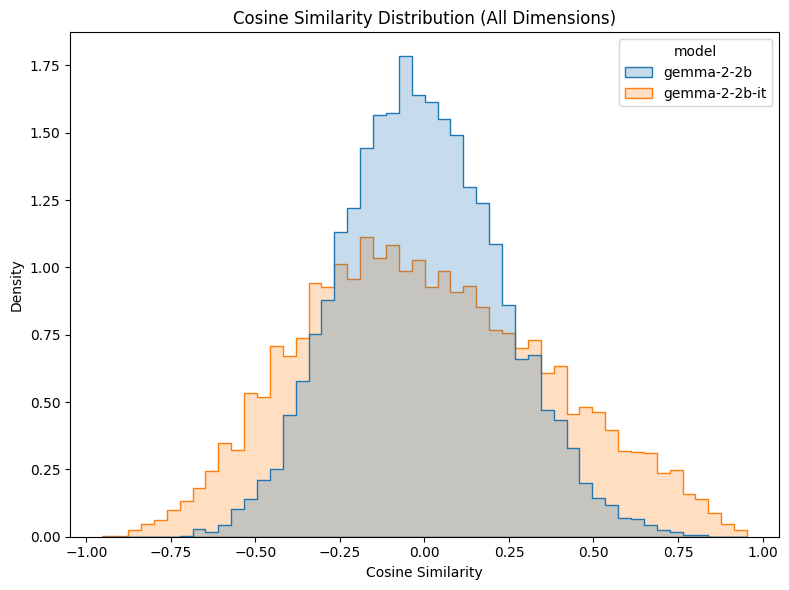

In [96]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
from scipy.spatial.distance import pdist, squareform

# --- Extract embeddings for both models ---
X_2b    = embed_gemma_2_2b.filter(like="dim_").values
X_2b_it = embed_gemma_2_2b_it.filter(like="dim_").values

# --- Compute cosine similarities ---
cos_sim_2b    = cosine_similarity(X_2b)
cos_sim_2b_it = cosine_similarity(X_2b_it)

# --- Extract upper triangle (excluding diagonal) ---
triu_indices = np.triu_indices_from(cos_sim_2b, k=1)
sims_2b      = cos_sim_2b[triu_indices]
sims_2b_it   = cos_sim_2b_it[triu_indices]

# --- Prepare dataframe for plotting ---
df_cos = pd.DataFrame({
    "similarity": np.concatenate([sims_2b, sims_2b_it]),
    "model": ["gemma-2-2b"] * len(sims_2b) + ["gemma-2-2b-it"] * len(sims_2b_it)
})

# --- Plot ---
plt.figure(figsize=(8, 6))
sns.histplot(data=df_cos, x="similarity", hue="model", bins=50, element="step", stat="density", common_norm=False)
plt.title("Cosine Similarity Distribution (All Dimensions)")
plt.xlabel("Cosine Similarity")
plt.ylabel("Density")
plt.tight_layout()
plt.show()


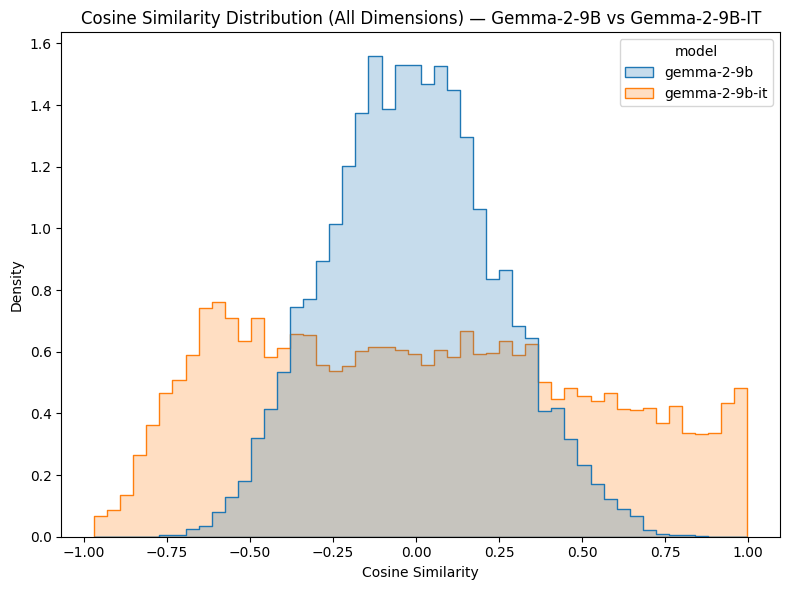

In [97]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity

# --- Extract embeddings for both models ---
X_9b    = embed_gemma_2_9b.filter(like="dim_").values
X_9b_it = embed_gemma_2_9b_it.filter(like="dim_").values

# --- Compute cosine similarities ---
cos_sim_9b    = cosine_similarity(X_9b)
cos_sim_9b_it = cosine_similarity(X_9b_it)

# --- Extract upper triangle (excluding diagonal) ---
triu_indices = np.triu_indices_from(cos_sim_9b, k=1)
sims_9b      = cos_sim_9b[triu_indices]
sims_9b_it   = cos_sim_9b_it[triu_indices]

# --- Prepare dataframe for plotting ---
df_cos_9b = pd.DataFrame({
    "similarity": np.concatenate([sims_9b, sims_9b_it]),
    "model": ["gemma-2-9b"] * len(sims_9b) + ["gemma-2-9b-it"] * len(sims_9b_it)
})

# --- Plot ---
plt.figure(figsize=(8, 6))
sns.histplot(data=df_cos_9b, x="similarity", hue="model", bins=50, element="step", stat="density", common_norm=False)
plt.title("Cosine Similarity Distribution (All Dimensions) — Gemma-2-9B vs Gemma-2-9B-IT")
plt.xlabel("Cosine Similarity")
plt.ylabel("Density")
plt.tight_layout()
plt.show()


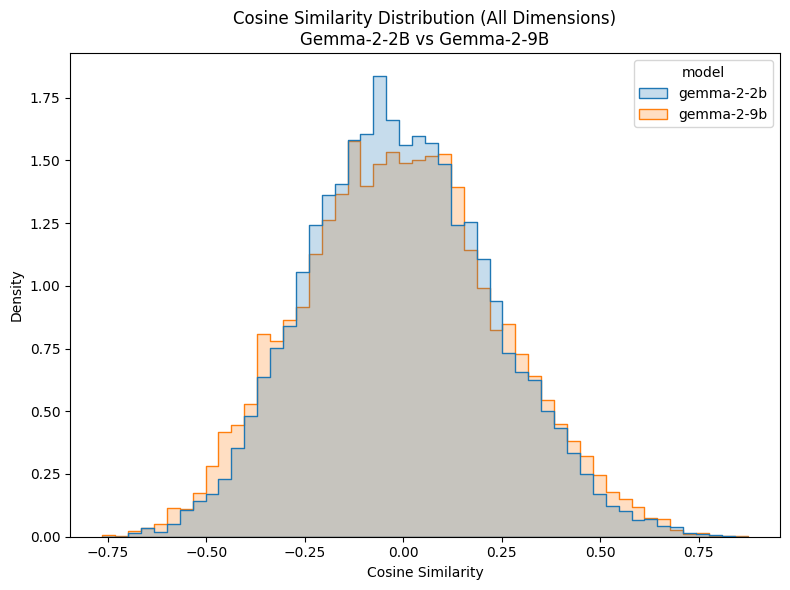

In [98]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity

# --- Extract embeddings ---
X_2b = embed_gemma_2_2b.filter(like="dim_").values
X_9b = embed_gemma_2_9b.filter(like="dim_").values

# --- Compute cosine similarity matrices ---
cos_sim_2b = cosine_similarity(X_2b)
cos_sim_9b = cosine_similarity(X_9b)

# --- Extract upper triangle (excluding diagonal) ---
triu_indices = np.triu_indices_from(cos_sim_2b, k=1)
sims_2b = cos_sim_2b[triu_indices]
sims_9b = cos_sim_9b[triu_indices]

# --- Combine into DataFrame ---
df_cos = pd.DataFrame({
    "similarity": np.concatenate([sims_2b, sims_9b]),
    "model": ["gemma-2-2b"] * len(sims_2b) + ["gemma-2-9b"] * len(sims_9b)
})

# --- Plot ---
plt.figure(figsize=(8, 6))
sns.histplot(data=df_cos, x="similarity", hue="model", bins=50, element="step", stat="density", common_norm=False)
plt.title("Cosine Similarity Distribution (All Dimensions)\nGemma-2-2B vs Gemma-2-9B")
plt.xlabel("Cosine Similarity")
plt.ylabel("Density")
plt.tight_layout()
plt.show()


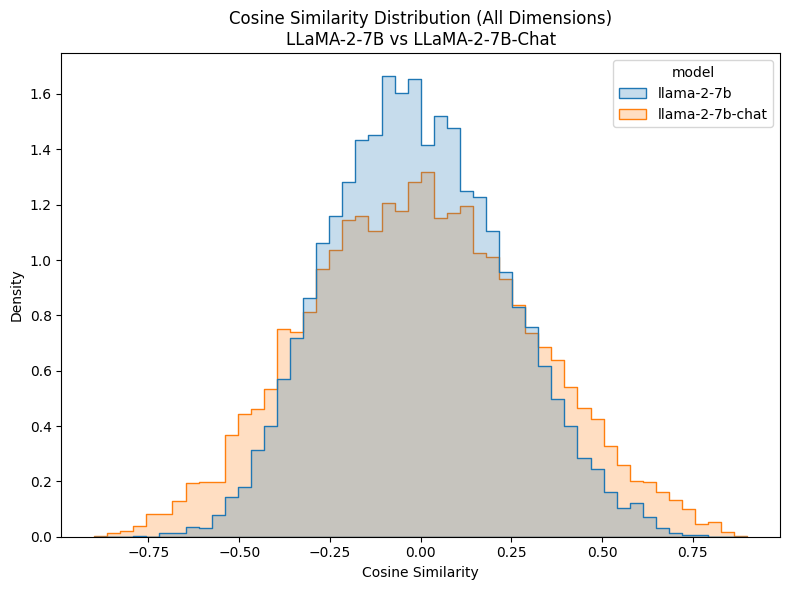

In [99]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity

# --- Extract embeddings ---
X_7b = embed_llama2_7b.filter(like="dim_").values
X_7b_chat = embed_llama2_7b_chat.filter(like="dim_").values

# --- Compute cosine similarity matrices ---
cos_sim_7b = cosine_similarity(X_7b)
cos_sim_7b_chat = cosine_similarity(X_7b_chat)

# --- Extract upper triangle (excluding diagonal) ---
triu_indices = np.triu_indices_from(cos_sim_7b, k=1)
sims_7b = cos_sim_7b[triu_indices]
sims_7b_chat = cos_sim_7b_chat[triu_indices]

# --- Combine into DataFrame ---
df_cos_llama = pd.DataFrame({
    "similarity": np.concatenate([sims_7b, sims_7b_chat]),
    "model": ["llama-2-7b"] * len(sims_7b) + ["llama-2-7b-chat"] * len(sims_7b_chat)
})

# --- Plot ---
plt.figure(figsize=(8, 6))
sns.histplot(data=df_cos_llama, x="similarity", hue="model", bins=50, element="step", stat="density", common_norm=False)
plt.title("Cosine Similarity Distribution (All Dimensions)\nLLaMA-2-7B vs LLaMA-2-7B-Chat")
plt.xlabel("Cosine Similarity")
plt.ylabel("Density")
plt.tight_layout()
plt.show()


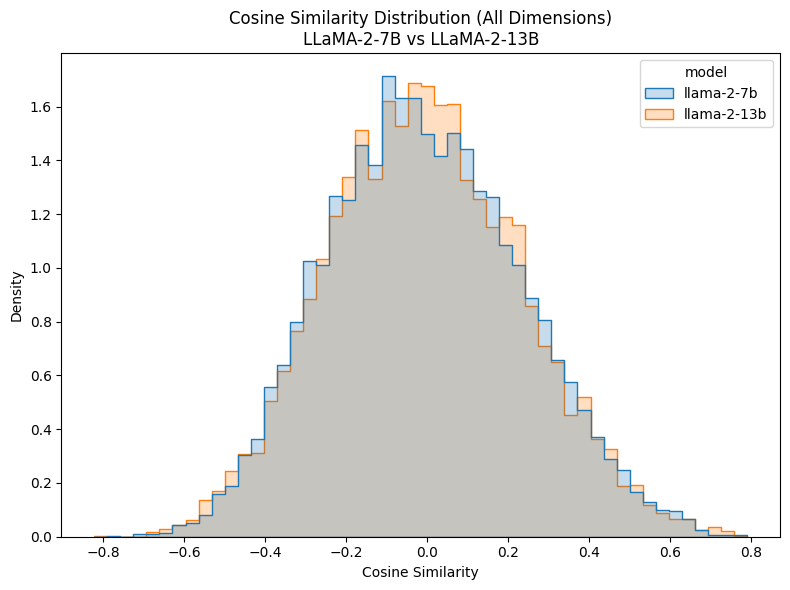

In [100]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity

# --- Extract embeddings ---
X_7b = embed_llama2_7b.filter(like="dim_").values
X_13b = embed_llama2_13b.filter(like="dim_").values

# --- Compute cosine similarity matrices ---
cos_sim_7b = cosine_similarity(X_7b)
cos_sim_13b = cosine_similarity(X_13b)

# --- Extract upper triangle (excluding diagonal) ---
triu_indices = np.triu_indices_from(cos_sim_7b, k=1)
sims_7b = cos_sim_7b[triu_indices]
sims_13b = cos_sim_13b[triu_indices]

# --- Combine into DataFrame ---
df_cos_llama_base = pd.DataFrame({
    "similarity": np.concatenate([sims_7b, sims_13b]),
    "model": ["llama-2-7b"] * len(sims_7b) + ["llama-2-13b"] * len(sims_13b)
})

# --- Plot ---
plt.figure(figsize=(8, 6))
sns.histplot(data=df_cos_llama_base, x="similarity", hue="model", bins=50, element="step", stat="density", common_norm=False)
plt.title("Cosine Similarity Distribution (All Dimensions)\nLLaMA-2-7B vs LLaMA-2-13B")
plt.xlabel("Cosine Similarity")
plt.ylabel("Density")
plt.tight_layout()
plt.show()


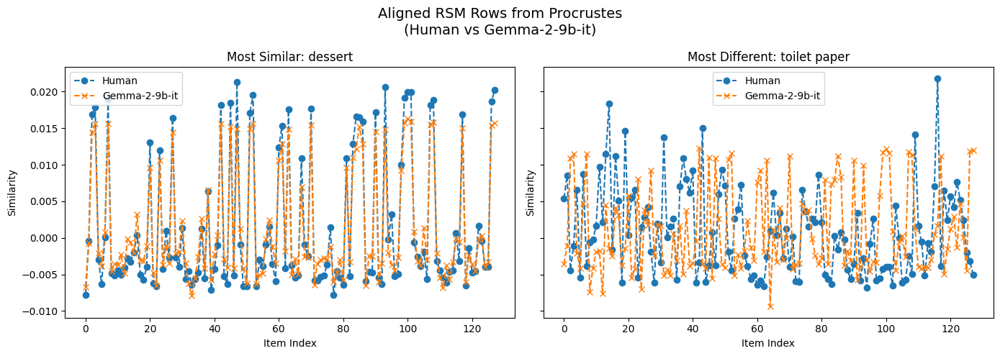

In [101]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.spatial import distance, procrustes

# --- Helper ---
def get_rsm(X, metric="cosine"):
    dists = distance.squareform(distance.pdist(X, metric=metric))
    return 1 - dists if metric == "cosine" else -dists  # similarity

# --- Shared items and aligned matrices ---
shared_items = sorted(set(embed_human["item"]) & set(embed_gemma_2_9b_it["item"]))
X_h = embed_human[embed_human["item"].isin(shared_items)].sort_values("item").filter(like="dim_").values
X_g = embed_gemma_2_9b_it[embed_gemma_2_9b_it["item"].isin(shared_items)].sort_values("item").filter(like="dim_").values
item_labels = embed_human[embed_human["item"].isin(shared_items)].sort_values("item")["item"].values

# --- RSMs ---
R_h = get_rsm(X_h, metric="cosine")
R_g = get_rsm(X_g, metric="cosine")

# --- Procrustes alignment ---
mtx1, mtx2, _ = procrustes(R_h, R_g)
pairwise_dists = np.linalg.norm(mtx1 - mtx2, axis=1)

# --- Find items with lowest and highest distances ---
idx_min = np.argmin(pairwise_dists)
idx_max = np.argmax(pairwise_dists)

# --- Plot RSM rows for those items ---
fig, axes = plt.subplots(1, 2, figsize=(14, 5), sharey=True)

for ax, idx, label in zip(axes, [idx_min, idx_max], ["Most Similar", "Most Different"]):
    ax.plot(mtx1[idx], label="Human", linestyle="--", marker="o")
    ax.plot(mtx2[idx], label="Gemma-2-9b-it", linestyle="--", marker="x")
    ax.set_title(f"{label}: {item_labels[idx]}")
    ax.set_xlabel("Item Index")
    ax.set_ylabel("Similarity")
    ax.legend()

plt.suptitle("Aligned RSM Rows from Procrustes\n(Human vs Gemma-2-9b-it)", fontsize=14)
plt.tight_layout()
plt.show()


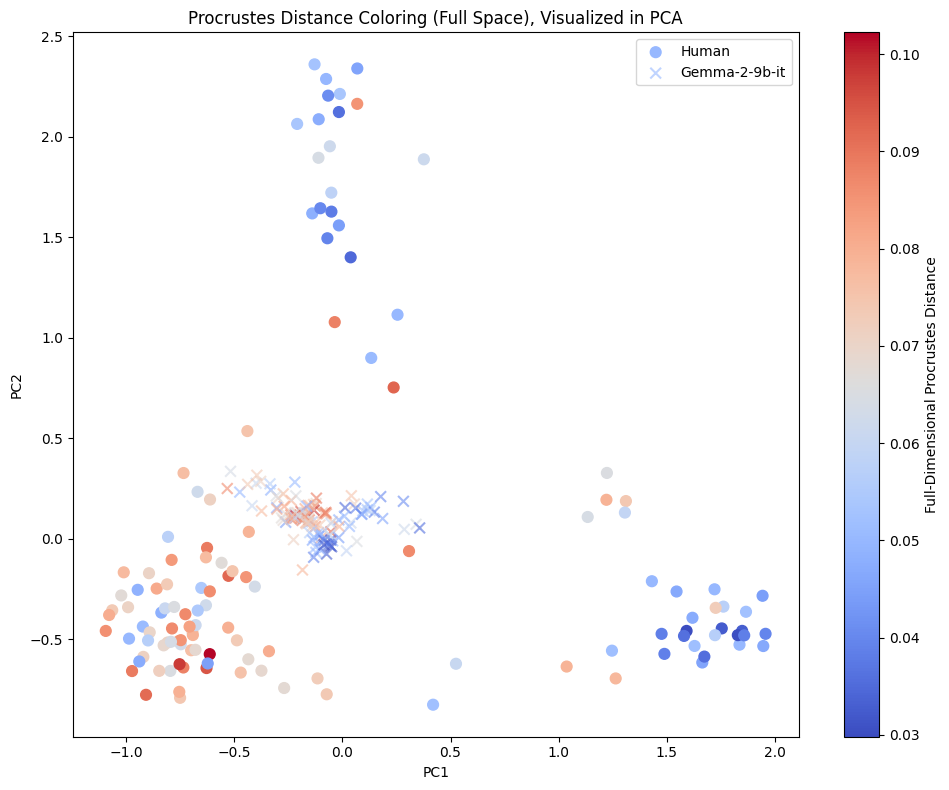

In [103]:
import pandas as pd
import numpy as np
from scipy.spatial import procrustes
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# --- Extract and align ---
shared = sorted(set(embed_human["item"]).intersection(embed_gemma_2_9b_it["item"]))
human_df = embed_human[embed_human["item"].isin(shared)].sort_values("item").reset_index(drop=True)
model_df = embed_gemma_2_9b_it[embed_gemma_2_9b_it["item"].isin(shared)].sort_values("item").reset_index(drop=True)

X_h = human_df.filter(like="dim_").values
X_m = model_df.filter(like="dim_").values

# --- Spatial Procrustes alignment ---
mtx_h, mtx_m, _ = procrustes(X_h, X_m)

# --- Compute full-dimensional distances ---
diffs = np.linalg.norm(mtx_h - mtx_m, axis=1)

# --- PCA for visualization ---
pca = PCA(n_components=2, random_state=42)
X_h_pca = pca.fit_transform(X_h)
X_m_pca = pca.transform(X_m)

# --- Plot ---
plt.figure(figsize=(10, 8))

sc = plt.scatter(X_h_pca[:, 0], X_h_pca[:, 1],
                 c=diffs, cmap="coolwarm", s=60, label="Human")

plt.scatter(X_m_pca[:, 0], X_m_pca[:, 1],
            c=diffs, cmap="coolwarm", s=60, marker="x", alpha=0.6, label="Gemma-2-9b-it")

plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title("Procrustes Distance Coloring (Full Space), Visualized in PCA")
plt.colorbar(sc, label="Full-Dimensional Procrustes Distance")
plt.legend()
plt.tight_layout()
plt.show()


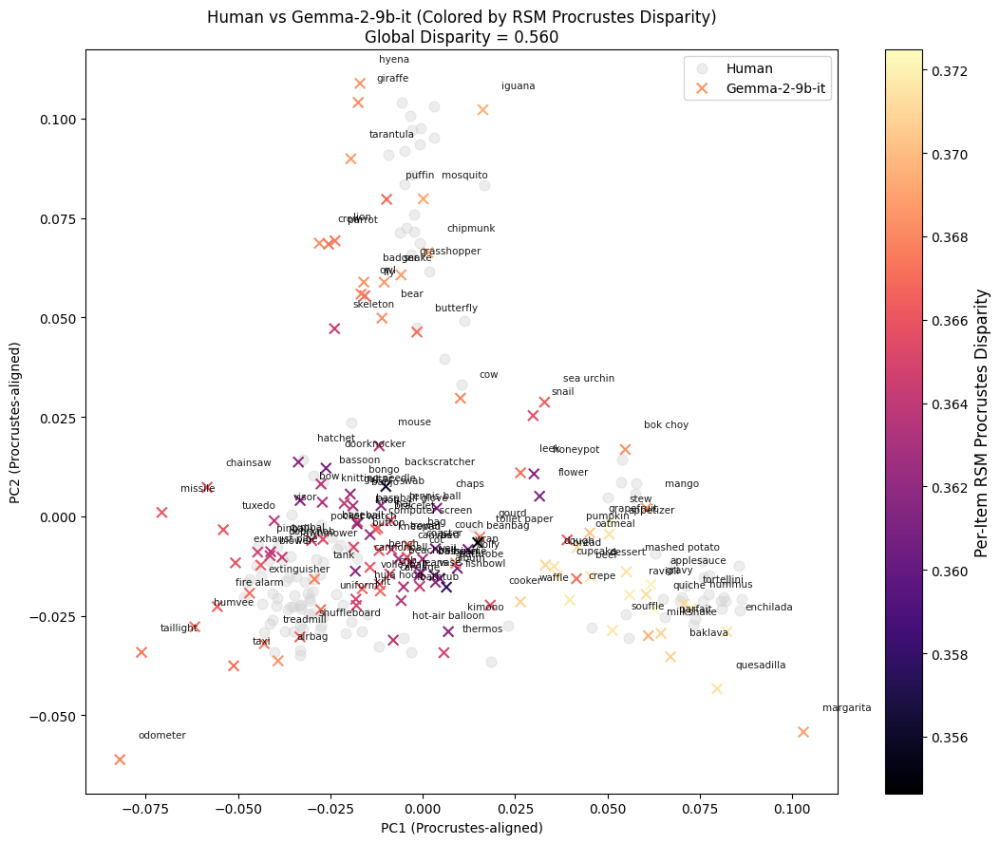

Top 20 Items with Highest Procrustes RSM Disparity:
         item  disparity
         stew   0.372482
       quiche   0.372433
   applesauce   0.372197
       hummus   0.371876
      ravioli   0.371870
        crepe   0.371703
      cupcake   0.371633
      dessert   0.371611
      souffle   0.371611
    enchilada   0.371588
mashed potato   0.371465
        bread   0.371440
    appetizer   0.371435
   quesadilla   0.371370
        gravy   0.371231
      oatmeal   0.371229
        dough   0.370973
   tortellini   0.370953
      parfait   0.370871
      baklava   0.370798


In [108]:
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from scipy.spatial import procrustes
from scipy.spatial.distance import squareform, pdist

# --- Step 1: Align shared items ---
shared = sorted(set(embed_human["item"]).intersection(embed_gemma_2_9b_it["item"]))
human_df = embed_human[embed_human["item"].isin(shared)].sort_values("item").reset_index(drop=True)
model_df = embed_gemma_2_9b_it[embed_gemma_2_9b_it["item"].isin(shared)].sort_values("item").reset_index(drop=True)

X_human = human_df.filter(like="dim_").values
X_model = model_df.filter(like="dim_").values
item_labels = model_df["item"].tolist()

# --- Step 2: Compute full RSMs using cosine distance ---
human_rsm = squareform(pdist(X_human, metric="cosine"))
model_rsm = squareform(pdist(X_model, metric="cosine"))

# --- Step 3: Compute per-item Procrustes disparities ---
disparities = []
for i in range(len(shared)):
    # Remove row/col i from both matrices
    h_sub = np.delete(np.delete(human_rsm, i, axis=0), i, axis=1)
    m_sub = np.delete(np.delete(model_rsm, i, axis=0), i, axis=1)
    _, _, disparity = procrustes(h_sub, m_sub)
    disparities.append(disparity)

disparities = np.array(disparities)
model_df["disparity"] = disparities

# --- Step 4: Procrustes alignment of raw embeddings ---
mtx1, mtx2, disparity_global = procrustes(X_human, X_model)

# --- Step 5: PCA visualization (after alignment) ---
pca = PCA(n_components=2, random_state=42)
X_human_pca = pca.fit_transform(mtx1)
X_model_pca = pca.transform(mtx2)

# --- Step 6: Plot ---
plt.figure(figsize=(11, 9))

# Human embeddings (not colored)
plt.scatter(X_human_pca[:, 0], X_human_pca[:, 1],
            c="lightgray", s=60, alpha=0.4, label="Human")

# Model embeddings colored by disparity
sc = plt.scatter(X_model_pca[:, 0], X_model_pca[:, 1],
                 c=disparities, cmap="magma", s=60, marker="x", label="Gemma-2-9b-it")

# Add text labels near model points
for i, txt in enumerate(item_labels):
    plt.text(X_model_pca[i, 0] + 0.005, X_model_pca[i, 1] + 0.005,
             txt, fontsize=7.5, alpha=0.9, ha='left', va='bottom')

# Colorbar
cb = plt.colorbar(sc)
cb.set_label("Per-Item RSM Procrustes Disparity", fontsize=12)

# Labels and layout
plt.xlabel("PC1 (Procrustes-aligned)")
plt.ylabel("PC2 (Procrustes-aligned)")
plt.title(f"Human vs Gemma-2-9b-it (Colored by RSM Procrustes Disparity)\nGlobal Disparity = {disparity_global:.3f}")
plt.legend()
plt.tight_layout()
plt.show()

# --- Step 7: Top 20 items by RSM disparity ---
top_20 = model_df[["item", "disparity"]].sort_values("disparity", ascending=False).head(20)
print("Top 20 Items with Highest Procrustes RSM Disparity:")
print(top_20.to_string(index=False))


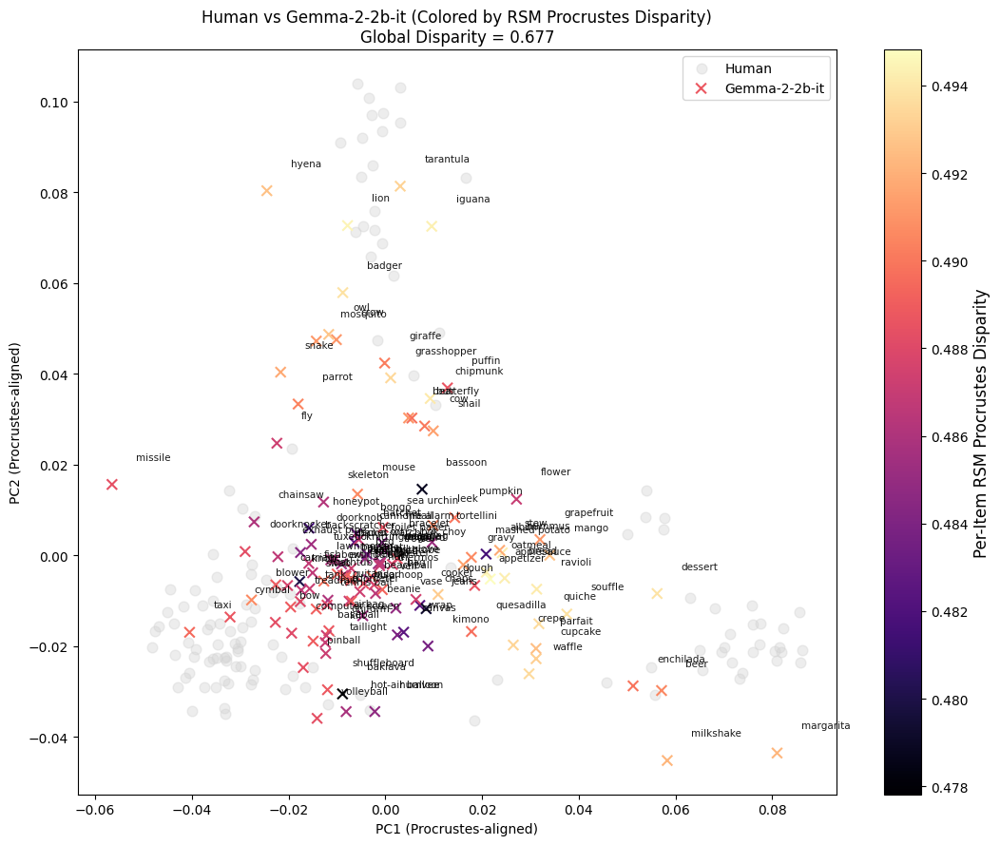

Top 20 Items with Highest Procrustes RSM Disparity:
       item  disparity
 applesauce   0.494821
       lion   0.494488
     iguana   0.494305
    oatmeal   0.494301
      bread   0.494227
     hummus   0.494162
    ravioli   0.494100
   chipmunk   0.494090
    dessert   0.493858
    souffle   0.493794
     badger   0.493771
     quiche   0.493612
     waffle   0.493496
grasshopper   0.493450
      crepe   0.493358
  tarantula   0.493253
    cupcake   0.493157
      dough   0.492973
        owl   0.492804
      mango   0.492612


In [110]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from scipy.spatial import procrustes
from scipy.spatial.distance import squareform, pdist

# --- Step 1: Align shared items ---
shared = sorted(set(embed_human["item"]).intersection(embed_gemma_2_2b_it["item"]))
human_df = embed_human[embed_human["item"].isin(shared)].sort_values("item").reset_index(drop=True)
model_df = embed_gemma_2_2b_it[embed_gemma_2_2b_it["item"].isin(shared)].sort_values("item").reset_index(drop=True)

X_human = human_df.filter(like="dim_").values
X_model = model_df.filter(like="dim_").values
item_labels = model_df["item"].tolist()

# --- Step 2: Compute full RSMs using cosine distance ---
human_rsm = squareform(pdist(X_human, metric="cosine"))
model_rsm = squareform(pdist(X_model, metric="cosine"))

# --- Step 3: Compute per-item Procrustes disparities ---
disparities = []
for i in range(len(shared)):
    h_sub = np.delete(np.delete(human_rsm, i, axis=0), i, axis=1)
    m_sub = np.delete(np.delete(model_rsm, i, axis=0), i, axis=1)
    _, _, disparity = procrustes(h_sub, m_sub)
    disparities.append(disparity)

disparities = np.array(disparities)
model_df["disparity"] = disparities

# --- Step 4: Procrustes alignment of raw embeddings ---
mtx1, mtx2, disparity_global = procrustes(X_human, X_model)

# --- Step 5: PCA visualization (after alignment) ---
pca = PCA(n_components=2, random_state=42)
X_human_pca = pca.fit_transform(mtx1)
X_model_pca = pca.transform(mtx2)

# --- Step 6: Plot ---
plt.figure(figsize=(11, 9))

# Human embeddings (gray background)
plt.scatter(X_human_pca[:, 0], X_human_pca[:, 1],
            c="lightgray", s=60, alpha=0.4, label="Human")

# Model embeddings (colored by disparity)
sc = plt.scatter(X_model_pca[:, 0], X_model_pca[:, 1],
                 c=disparities, cmap="magma", s=60, marker="x", label="Gemma-2-2b-it")

# Add text labels close to points
for i, txt in enumerate(item_labels):
    plt.text(X_model_pca[i, 0] + 0.005, X_model_pca[i, 1] + 0.005,
             txt, fontsize=7.5, alpha=0.9, ha='left', va='bottom')

# Colorbar
cb = plt.colorbar(sc)
cb.set_label("Per-Item RSM Procrustes Disparity", fontsize=12)

# Labels
plt.xlabel("PC1 (Procrustes-aligned)")
plt.ylabel("PC2 (Procrustes-aligned)")
plt.title(f"Human vs Gemma-2-2b-it (Colored by RSM Procrustes Disparity)\nGlobal Disparity = {disparity_global:.3f}")
plt.legend()
plt.tight_layout()
plt.show()

# --- Step 7: Top 20 items by RSM disparity ---
top_20 = model_df[["item", "disparity"]].sort_values("disparity", ascending=False).head(20)
print("Top 20 Items with Highest Procrustes RSM Disparity:")
print(top_20.to_string(index=False))


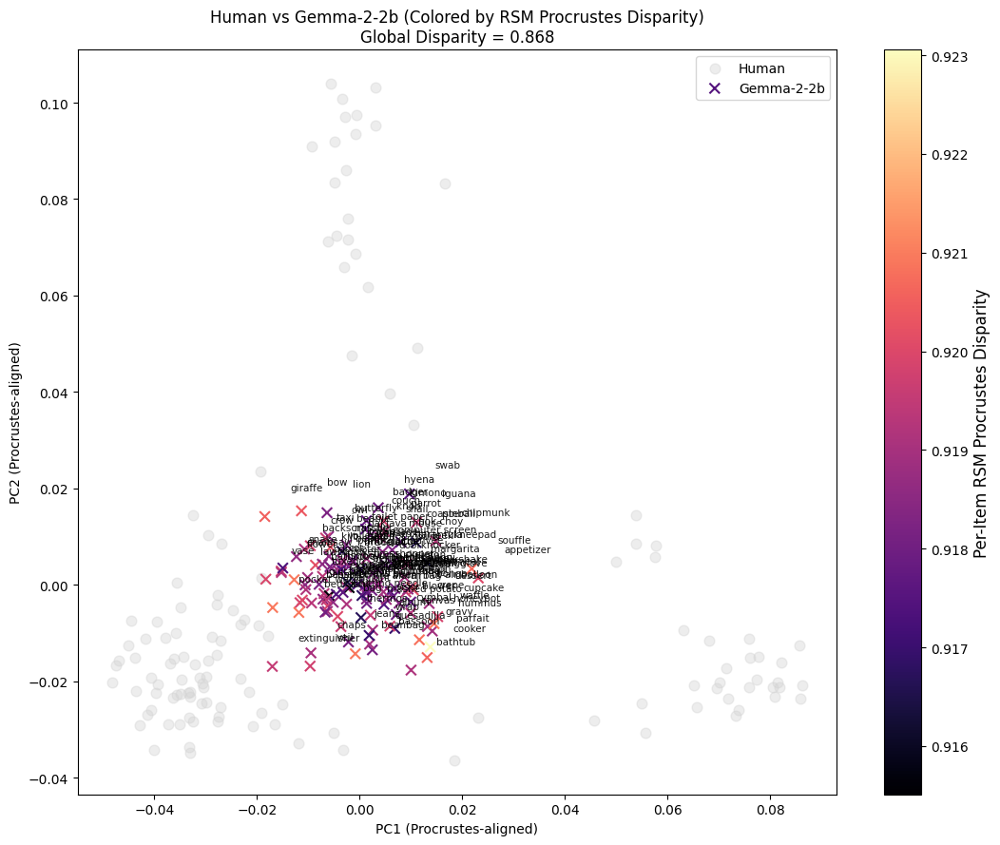

Top 20 Items with Highest Procrustes RSM Disparity:
        item  disparity
     parfait   0.923057
   lawnmower   0.920927
pocket watch   0.920921
     beanbag   0.920908
         bed   0.920886
      waffle   0.920858
       gravy   0.920792
     souffle   0.920671
      cooker   0.920608
     giraffe   0.920530
         bow   0.920347
   milkshake   0.920187
        kilt   0.920157
      beanie   0.920115
     oatmeal   0.920056
   appetizer   0.920018
      guitar   0.920009
         bag   0.919982
        vase   0.919940
   taillight   0.919847


In [111]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from scipy.spatial import procrustes
from scipy.spatial.distance import squareform, pdist

# --- Step 1: Align shared items ---
shared = sorted(set(embed_human["item"]).intersection(embed_gemma_2_2b["item"]))
human_df = embed_human[embed_human["item"].isin(shared)].sort_values("item").reset_index(drop=True)
model_df = embed_gemma_2_2b[embed_gemma_2_2b["item"].isin(shared)].sort_values("item").reset_index(drop=True)

X_human = human_df.filter(like="dim_").values
X_model = model_df.filter(like="dim_").values
item_labels = model_df["item"].tolist()

# --- Step 2: Compute full RSMs using cosine distance ---
human_rsm = squareform(pdist(X_human, metric="cosine"))
model_rsm = squareform(pdist(X_model, metric="cosine"))

# --- Step 3: Compute per-item Procrustes disparities ---
disparities = []
for i in range(len(shared)):
    h_sub = np.delete(np.delete(human_rsm, i, axis=0), i, axis=1)
    m_sub = np.delete(np.delete(model_rsm, i, axis=0), i, axis=1)
    _, _, disparity = procrustes(h_sub, m_sub)
    disparities.append(disparity)

disparities = np.array(disparities)
model_df["disparity"] = disparities

# --- Step 4: Procrustes alignment of raw embeddings ---
mtx1, mtx2, disparity_global = procrustes(X_human, X_model)

# --- Step 5: PCA visualization (after alignment) ---
pca = PCA(n_components=2, random_state=42)
X_human_pca = pca.fit_transform(mtx1)
X_model_pca = pca.transform(mtx2)

# --- Step 6: Plot ---
plt.figure(figsize=(11, 9))

# Human embeddings (gray)
plt.scatter(X_human_pca[:, 0], X_human_pca[:, 1],
            c="lightgray", s=60, alpha=0.4, label="Human")

# Model embeddings (colored by disparity)
sc = plt.scatter(X_model_pca[:, 0], X_model_pca[:, 1],
                 c=disparities, cmap="magma", s=60, marker="x", label="Gemma-2-2b")

# Add text labels near model points
for i, txt in enumerate(item_labels):
    plt.text(X_model_pca[i, 0] + 0.005, X_model_pca[i, 1] + 0.005,
             txt, fontsize=7.5, alpha=0.9, ha='left', va='bottom')

# Colorbar
cb = plt.colorbar(sc)
cb.set_label("Per-Item RSM Procrustes Disparity", fontsize=12)

# Labels
plt.xlabel("PC1 (Procrustes-aligned)")
plt.ylabel("PC2 (Procrustes-aligned)")
plt.title(f"Human vs Gemma-2-2b (Colored by RSM Procrustes Disparity)\nGlobal Disparity = {disparity_global:.3f}")
plt.legend()
plt.tight_layout()
plt.show()

# --- Step 7: Top 20 items by RSM disparity ---
top_20 = model_df[["item", "disparity"]].sort_values("disparity", ascending=False).head(20)
print("Top 20 Items with Highest Procrustes RSM Disparity:")
print(top_20.to_string(index=False))
